In [8]:
import re
import numpy as np
import pandas as pd
import scanpy as sc
import squidpy as sq
import anndata as ad
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from spatial_analysis.utils import ObsHelper

## Read in Data and Fix Metadata

In [9]:
adata = ad.read_h5ad(r'AnnDataFiles/1-output_nsclc_ytma_raw_preandpost.h5ad')
adata

AnnData object with n_obs × n_vars = 189854 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features'
    obsm: 'marker_positivity', 'spatial'

In [10]:
# Check the pre/post treatment label of the tissue samples
set(adata.obs['prepost'])

{'Post', 'Pre'}

In [11]:
# Select Lung primary, pre-treatment samples with non-missing CB6
adata = adata[adata.obs['biopsysite'].isin(['Lung', 'Lung primary']) & adata.obs['prepost'].isin(['Pre']) & ~np.isnan(adata.obs['CB6'])]

In [12]:
adata

View of AnnData object with n_obs × n_vars = 135346 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features'
    obsm: 'marker_positivity', 'spatial'

In [16]:
# Get cohort patient proportions 
samplepropshelper = ObsHelper(adata, "patientid")
cohortproportions = {}
ctcols = ['cohort']#
for ctcol in ctcols:
    cohortproportions[f"{ctcol}"] = samplepropshelper.get_metadata_df(
    [ctcol], 
    skey_handle="category_proportions")

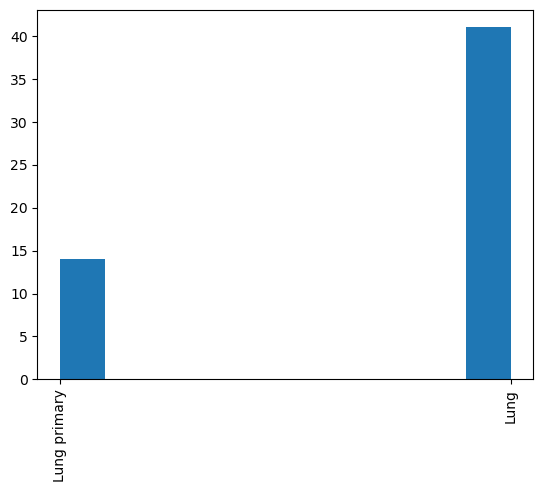

In [18]:
plt.hist([a.biopsysite.iloc[0] for _, a in adata.obs.groupby(by='patientid')])
plt.xticks(rotation=90)
plt.show()

In [19]:
# Biopsy site proportions

samplepropshelper = ObsHelper(adata, "patientid")
sampleproportions = {}
ctcols = ['biopsysite']#
for ctcol in ctcols:
    sampleproportions[f"{ctcol}"] = samplepropshelper.get_metadata_df(
    [ctcol], 
    skey_handle="category_proportions")

In [37]:
colstofill = ['pfs.12months','pfs.6months','OS.18months', 'OS.24months']
for col in colstofill:
    adata.obs[colstofill] = adata.obs[colstofill].fillna(0)

In [38]:
adata.obs['celltypes'].value_counts()

celltypes
tumorcells            54294
macrophagecells       19517
cd4tcells             10640
fibroblastcells        9741
myofibroblastcells     8123
cd8tcells              7046
endothilialcells       5123
granulocytecells       4240
immunenoscells         4219
othercells             4035
cd4tregcells           2816
plasmacells            2258
myeloidnoscells        1874
bcells                 1338
artifactcells            82
Name: count, dtype: int64

## Generate Functional and Meta Marker Columns

In [39]:
cols = ['asct2', 'asct2_high', 'atpa5', 'atpa5_high', 'cd11b', 'cd11c', 'cd14',
       'cd163', 'cd19', 'cd20', 'cd21', 'cd31', 'cd34', 'cd3e', 'cd4', 'cd44',
       'cd44_high', 'cd45', 'cd45ro', 'cd57', 'cd68', 'cd8', 'citratesynthase',
       'citratesynthase_high', 'col4', 'cpt1a', 'cpt1a_high', 'ecadherin',
       'foxp3', 'g6pd', 'g6pd_high', 'glut1', 'glut1_high', 'granzymeb',
       'hexokinase1', 'hexokinase1_high', 'hlaa', 'hlaa_high', 'icos', 'idh2',
       'idh2_high', 'ido1', 'ido1_high', 'ki67', 'lag3', 'ldha', 'ldha_high',
       'nakatpase', 'pancytokeratin', 'pax5', 'pd1', 'pdl1', 'pdl1_high',
       'pnrf2', 'pnrf2_high', 'sdha', 'sdha_high', 'sma', 'vimentin']
cols = [c.replace('_', '') for c in cols]

adata.obsm["marker_positivity_nans"] = adata.obsm["marker_positivity"]
for i,col in enumerate(cols):
    adata.obsm["marker_positivity_nans"][col] = adata.obsm["marker_positivity"][col].replace({'0':np.nan, 0:np.nan, 1: f"{col}"})

immunefunc = ['pd1','pdl1', 'pdl1_high','granzymeb','icos','ido1', 'ido1_high']
immunefunc = [c.replace('_', '') for c in immunefunc]
metafunc = ['asct2', 'asct2_high', 'atpa5', 'atpa5_high','citratesynthase','citratesynthase_high','cpt1a', 'cpt1a_high', 'g6pd', 'g6pd_high', 'glut1', 'glut1_high','hexokinase1', 'hexokinase1_high',
            'idh2', 'idh2_high','nakatpase','pnrf2', 'pnrf2_high', 'sdha', 'sdha_high']
metafunc = [c.replace('_', '') for c in metafunc]
tumourfunc=['pdl1', 'pdl1_high','vimentin','ki67','ido1', 'ido1_high','hlaa', 'hlaa_high']
tumourfunc = [c.replace('_', '') for c in tumourfunc]

adata.obs['celltypes'] = adata.obs['celltypes'].astype('str')

In [40]:
adata_nontumour= adata[~adata.obs['celltypes'].isin(['tumorcells'])].copy()
adata_tumour= adata[adata.obs['celltypes'].isin(['tumorcells'])].copy()

In [41]:
def labelcellpositivity(adata, ctcol, positivitylabels):
    adata.obs[ctcol] = adata.obs['celltypes'] + adata.obsm["marker_positivity_nans"][positivitylabels].fillna('').agg('_'.join, axis=1)
    adata.obs[ctcol] = adata.obs[ctcol].astype(str).astype("category")
    return adata

In [45]:
adata_tumour

AnnData object with n_obs × n_vars = 54294 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue', 'tumour_func', 'tumour_meta'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features'
    obsm: 'marker_positivity', 'spatial', 'marker_positivity_nans'

In [46]:
adata_nontumour = labelcellpositivity(adata = adata_nontumour, ctcol = 'Immune_func', positivitylabels = immunefunc)
adata_nontumour = labelcellpositivity(adata = adata_nontumour, ctcol = 'Immune_meta', positivitylabels = metafunc)

adata_tumour = labelcellpositivity(adata = adata_tumour, ctcol = 'tumour_func', positivitylabels = tumourfunc)
adata_tumour = labelcellpositivity(adata = adata_tumour, ctcol = 'tumour_meta', positivitylabels = metafunc)

In [47]:
adata.obs['tumournontumour'] = adata.obs['celltypes'] == 'tumorcells'
adata.obs['tumournontumour'] = adata.obs['tumournontumour'].replace({False: 'nontumorcells', True: 'tumorcells'})
adata.obs['tumournontumour'] = adata.obs['tumournontumour'].astype('category')

In [49]:
adata

AnnData object with n_obs × n_vars = 135346 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue', 'tumournontumour'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features'
    obsm: 'marker_positivity', 'spatial', 'marker_positivity_nans'

## Filter to Functional Groups with at least 200 Cells in Them

In [50]:
#only label cells with functional group if they are more than cut off, else label as base class cell
def summarisecounts(adata, ctcol, basectcol, cutoff):
    df = pd.DataFrame(adata.obs[ctcol].value_counts())
    df = df[df> cutoff].dropna()
    df.reset_index(inplace=True, names = 'ct')
    celllist = list(set(df['ct']))
    adata.obs[ctcol] = adata.obs.apply(lambda row: row[ctcol] if row[ctcol] in celllist else row[basectcol], axis=1)
    return adata

In [51]:
ctcols = ['Immune_func','Immune_meta']
for ctcol in ctcols:
    adata_nontumour = summarisecounts(adata=adata_nontumour, ctcol=ctcol, basectcol='celltypes',cutoff=200)

ctcols=['tumour_meta','tumour_func']
for ctcol in ctcols:
    adata_tumour = summarisecounts(adata=adata_tumour, ctcol=ctcol, basectcol='celltypes',cutoff=200)

## Assign to Groups

In [52]:
adata.obs = pd.merge(adata.obs, adata_nontumour.obs[['uuid', 'Immune_func']], on= 'uuid', how = 'left')
adata.obs = pd.merge(adata.obs, adata_nontumour.obs[['uuid', 'Immune_meta']], on= 'uuid', how = 'left')

adata.obs = pd.merge(adata.obs, adata_tumour.obs[['uuid', 'tumour_meta']], on= 'uuid', how = 'left')
adata.obs = pd.merge(adata.obs, adata_tumour.obs[['uuid', 'tumour_func']], on= 'uuid', how = 'left')

In [53]:
adata

AnnData object with n_obs × n_vars = 135346 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue', 'tumournontumour', 'Immune_func', 'Immune_meta', 'tumour_meta', 'tumour_func'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features'
    obsm: 'marker_positivity', 'spatial', 'marker_positivity_nans'

In [54]:
adata.obs['Immune_func'] = adata.obs[['celltypes','Immune_func']].ffill(axis=1).iloc[:, -1]
adata.obs['Immune_meta'] = adata.obs[['celltypes','Immune_meta']].ffill(axis=1).iloc[:, -1]

adata.obs['tumour_meta'] = adata.obs[['celltypes','tumour_meta']].ffill(axis=1).iloc[:, -1]
adata.obs['tumour_func'] = adata.obs[['celltypes','tumour_func']].ffill(axis=1).iloc[:, -1]

In [55]:
del adata.obsm['marker_positivity_nans']

In [56]:
adata.obsm['marker_positivity'].index = adata.obsm['marker_positivity'].index.astype('str')
adata.obs.index = adata.obs.index.astype('str')

In [57]:
set(adata.obs['tumour_func'])

{'artifactcells',
 'bcells',
 'cd4tcells',
 'cd4tregcells',
 'cd8tcells',
 'endothilialcells',
 'fibroblastcells',
 'granulocytecells',
 'immunenoscells',
 'macrophagecells',
 'myeloidnoscells',
 'myofibroblastcells',
 'othercells',
 'plasmacells',
 'tumorcells',
 'tumorcells_______',
 'tumorcells______hlaa_',
 'tumorcells______hlaa_hlaahigh',
 'tumorcells____ido1_ido1high__',
 'tumorcells____ido1_ido1high_hlaa_hlaahigh',
 'tumorcells___ki67____',
 'tumorcells___ki67___hlaa_',
 'tumorcells___ki67___hlaa_hlaahigh',
 'tumorcells__vimentin_____',
 'tumorcells__vimentin____hlaa_',
 'tumorcells__vimentin____hlaa_hlaahigh',
 'tumorcells__vimentin_ki67____',
 'tumorcellspdl1_______',
 'tumorcellspdl1______hlaa_',
 'tumorcellspdl1______hlaa_hlaahigh',
 'tumorcellspdl1___ki67___hlaa_',
 'tumorcellspdl1___ki67___hlaa_hlaahigh',
 'tumorcellspdl1_pdl1high______',
 'tumorcellspdl1_pdl1high_____hlaa_hlaahigh',
 'tumorcellspdl1_pdl1high__ki67___hlaa_hlaahigh'}

## Fix Marker Names and Create Metabolic Pathway Columns

In [58]:
replace_dict = {
        'asct2high': '_ASCT2high_',
        'atpa5high': '_ATPA5high_',
        'citratesynthasehigh': '_CITRATESYNTHASEhigh_',
        'cpt1ahigh': '_CPT1Ahigh_',
        'g6pdhigh': '_G6PDhigh_',
        'glut1high': '_GLUT1high_',
        'hexokinase1high': '_HEXOKINASE1high_',
        'idh2high': '_IDH2high_',
        'nakatpasehigh': '_NAKATPASEhigh_',
        'pnrf2high': '_PNRF2high_',
        'sdhahigh': '_SDHAhigh_',
        'pdhigh': '_PDhigh_',
        'asct2': '_ASCT2_',
        'atpa5': '_ATPA5_',
        'citratesynthase': '_CITRATESYNTHASE_',
        'cpt1a': '_CPT1A_',
        'g6pd': '_G6PD_',
        'glut1': '_GLUT1_',
        'hexokinase1': '_HEXOKINASE1_',
        'idh2': '_IDH2_',
        'nakatpase': '_NAKATPASE_',
        'pnrf2': '_PNRF2_',
        'sdha': '_SDHA_',
        'ido1high': '_IDO1_',
        'ido1': '_IDO1_',
        'granzymebhigh': '_Granzymeb_',
        'granzymeb': '_Granzymeb_',
        'icoshigh': '_ICOS_',
        'icos': '_ICOS_',
        'pd1high': '_PD1_',
        'pd1': '_PD1_',
        'pdl1high': '_PDL1_',
        'pdl1': '_PDL1_',
        'hlaahigh': '_HLAA_',
        'hlaa': '_HLAA_',
        'ki67': '_KI67_',
        'vimentin': "_VIMENTIN_",
    }

def fixLabels(lab):

    lab = lab.replace('_high', 'high')
    lab = lab.replace('_cells', 'cells')
    for key, item in replace_dict.items():
        lab = lab.replace(key, item)
    while '__' in lab:
        lab = lab.replace('__', '_')
    if lab[-1] == '_':
        lab = lab[:-1]

    return lab

In [59]:
def replacenth(string_, sub, wanted):
    while len(list(re.finditer(sub, string_))) > 1:
        where = [m.start() for m in re.finditer(sub, string_)][1]
        before = string_[:where]
        after = string_[where:]
        after = after.replace(sub, wanted, 1)
        string_ = before + after
    return string_

In [60]:
#Rename the cell labels, only hyphenate separations of celltypes and markers

adata.obs['Immune_meta'] =  adata.obs['Immune_meta'].apply(fixLabels)
adata.obs['Immune_func'] =  adata.obs['Immune_func'].apply(fixLabels)
adata.obs['tumour_meta'] =  adata.obs['tumour_meta'].apply(fixLabels)
adata.obs['tumour_func'] =  adata.obs['tumour_func'].apply(fixLabels)

In [63]:
# Check cell type labels
set(adata.obs['Immune_func'])

{'artifactcells',
 'bcells',
 'cd4tcells',
 'cd4tcells_Granzymeb',
 'cd4tcells_ICOS',
 'cd4tcells_IDO1',
 'cd4tcells_IDO1_IDO1',
 'cd4tcells_PD1',
 'cd4tcells_PD1_ICOS',
 'cd4tregcells',
 'cd4tregcells_ICOS',
 'cd4tregcells_PD1',
 'cd4tregcells_PD1_ICOS',
 'cd8tcells',
 'cd8tcells_Granzymeb',
 'cd8tcells_PD1',
 'cd8tcells_PD1_Granzymeb',
 'endothilialcells',
 'endothilialcells_IDO1',
 'endothilialcells_IDO1_IDO1',
 'fibroblastcells',
 'granulocytecells',
 'granulocytecells_IDO1',
 'immunenoscells',
 'immunenoscells_Granzymeb',
 'macrophagecells',
 'macrophagecells_Granzymeb',
 'macrophagecells_IDO1',
 'macrophagecells_IDO1_IDO1',
 'macrophagecells_PD1',
 'macrophagecells_PDL1',
 'myeloidnoscells',
 'myofibroblastcells',
 'othercells',
 'plasmacells',
 'plasmacells_Granzymeb',
 'tumorcells'}

In [64]:
set(adata.obs['tumour_func'])

{'artifactcells',
 'bcells',
 'cd4tcells',
 'cd4tregcells',
 'cd8tcells',
 'endothilialcells',
 'fibroblastcells',
 'granulocytecells',
 'immunenoscells',
 'macrophagecells',
 'myeloidnoscells',
 'myofibroblastcells',
 'othercells',
 'plasmacells',
 'tumorcells',
 'tumorcells_HLAA',
 'tumorcells_HLAA_HLAA',
 'tumorcells_IDO1_IDO1',
 'tumorcells_IDO1_IDO1_HLAA_HLAA',
 'tumorcells_KI67',
 'tumorcells_KI67_HLAA',
 'tumorcells_KI67_HLAA_HLAA',
 'tumorcells_PDL1',
 'tumorcells_PDL1_HLAA',
 'tumorcells_PDL1_HLAA_HLAA',
 'tumorcells_PDL1_KI67_HLAA',
 'tumorcells_PDL1_KI67_HLAA_HLAA',
 'tumorcells_PDL1_PDL1',
 'tumorcells_PDL1_PDL1_HLAA_HLAA',
 'tumorcells_PDL1_PDL1_KI67_HLAA_HLAA',
 'tumorcells_VIMENTIN',
 'tumorcells_VIMENTIN_HLAA',
 'tumorcells_VIMENTIN_HLAA_HLAA',
 'tumorcells_VIMENTIN_KI67'}

### Now compute metabolic pathways

In [65]:
# Define the pathways of the metabolic markers

pathways = {
    'AminoAcidUptake' : ['ASCT2high', 'ASCT2'],
    'ATPSynthesis'    : ['ATPA5high', 'ATPA5'],
    'TCACyle'         : ['CITRATESYNTHASEhigh', 'CITRATESYNTHASE'],
    'FatOxidation'    : ['CPT1Ahigh', 'CPT1A'],
    'PPP'             : ['G6PDhigh', 'G6PD'],
    'Glycolysis'      : ['GLUT1high', 'GLUT1'],
    'Regulatory'      : ['PNRF2high', 'PNRF2'],
    '': ['IDH2high', 'IDH2', 'HEXOKINASE1high', 'HEXOKINASE1', 'SDHAhigh', 'SDHA', 'NAKATPASEhigh', 'NAKATPASE'],
}

In [66]:
# Create the cell types that have metabolic and functional marker association

adata.obs['cell_types_immune_metapath'] = adata.obs['Immune_meta'].astype(str) + '_' +  adata.obs['Immune_func'].astype(str) + \
    '_' + adata.obs['tumour_meta'].astype(str) + '_' + adata.obs['tumour_func'].astype(str)

for path, markers in pathways.items():
    for marker in markers:
        adata.obs['cell_types_immune_metapath'] = adata.obs['cell_types_immune_metapath'].apply(lambda x: x.replace(marker, path))

cts = ['granulocytecells', 'tumorcells', 'bcells', 'plasmacells', 'cd4tregcells', 'endothilialcells', 'artifactcells', 'myeloidnoscells', 'myofibroblastcells', 'fibroblastcells', \
       'immunenoscells', 'cd4tcells', 'cd8tcells', 'macrophagecells', 'othercells', 'AminoAcidUptake', 'ATPSynthesis', 'TCACyle', 'Glycolysis', 'Regulatory', 'PPP', 'FatOxidation']
cts.extend([a[1:-1] for _, a in replace_dict.items()])

for ct in cts:
    adata.obs['cell_types_immune_metapath'] = adata.obs['cell_types_immune_metapath'].apply(
        lambda x: replacenth(x, ct, '')
    )

adata.obs['cell_types_immune_metapath'] = adata.obs['cell_types_immune_metapath'].apply(fixLabels)

In [67]:
set(adata.obs['cell_types_immune_metapath'])

{'artifactcells',
 'bcells',
 'cd4tcells',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Granzymeb',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_ICOS',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_IDO1',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_PD1',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_PD1_ICOS',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory_Granzymeb',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory_ICOS',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory_IDO1',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory_PD1',
 'cd4tcells_ATPSynthesis_TCACyle_Glycolysis_Regulatory_PD1_ICOS',
 'cd4tcells_Glycolysis',
 'cd4tcells_Glycolysis_Granzymeb',
 'cd4tcells_Glycolysis_ICOS',
 'cd4tcells_Glycolysis_IDO1',
 'cd4tcells_Glycolysis_PD1',
 'cd4tcells_Glycolysis_PD1_ICOS',
 'cd4tcells_Granzymeb',
 'cd4tcells_ICOS',
 'cd4tcells_IDO1',
 'cd4tcells_PD1',
 'cd4tcell

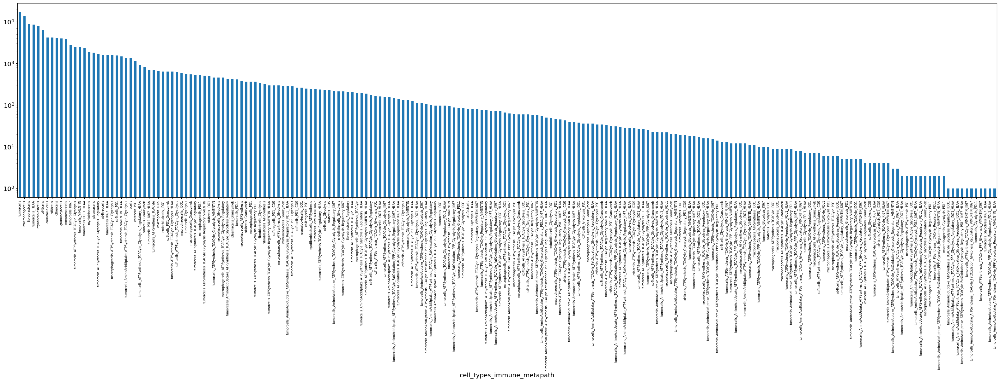

In [68]:
params = {'legend.fontsize': 'x-large',
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-small',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

plt.figure(figsize=(40, 8))
adata.obs['cell_types_immune_metapath'].value_counts().plot(kind='bar')
plt.yscale('log')

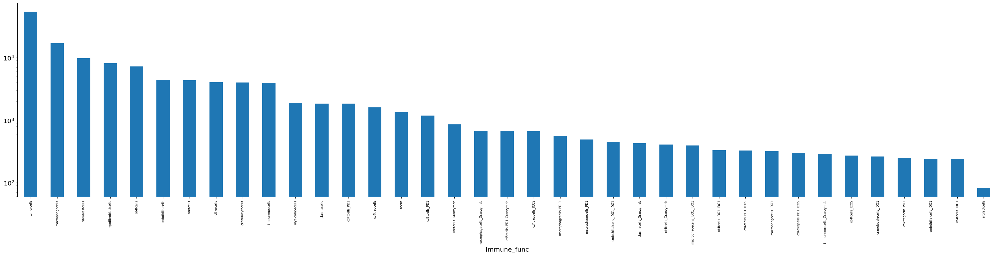

In [69]:
plt.figure(figsize=(40, 8))
adata.obs['Immune_func'].value_counts().plot(kind='bar')
plt.yscale('log')

In [70]:
adata

AnnData object with n_obs × n_vars = 135346 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue', 'tumournontumour', 'Immune_func', 'Immune_meta', 'tumour_meta', 'tumour_func', 'cell_types_immune_metapath'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features'
    obsm: 'marker_positivity', 'spatial'

In [71]:
# Metabolic Pathway Strings
pathwaysubstrings = ['ATPSynthesis', 'Glycolysis', 'TCACyle', 'Regulatory', 'AminoAcidUptake', 'FatOxidation', "PPP"]

In [72]:
# One hot encode the pathway vectors to do metabolic CN clustering
onehot_df = pd.DataFrame({substring: adata.obs['cell_types_immune_metapath'].str.contains(substring).astype(int) for substring in pathwaysubstrings}, index=adata.obs.index)

In [73]:
adata.obs = pd.concat([adata.obs, onehot_df], axis=1)

In [74]:
# Do the metabolic clustering
def compute_kmeans_neighborhoods(
    adata_,
    columns = None,
    n_clusters: int = 3,
    n_neighbors: int = 20,
    assignedLabel: str = 'MetaPathNeighbourhood'
):
    """
    Compute k-means clustering on metabolic neighborhoods using KNN graphs
        on metaoblic pathway vectors. (density dependent clustering)
    
    Parameters
    ----------
    adata : anndata.AnnData
        Annotated data matrix with cells as rows and features as columns.
    n_clusters : int, default=10
        Number of clusters for k-means clustering.
    n_neighbors : int, default=15
        Number of neighbors for KNN graph construction.
    assignedLabel: : str, defaul="MetaPathNeighbourhood"

    Returns
    -------
    adata_ : anndata.AnnData
    """
    # Get connectivities
    knn_graph = adata_.obsp['spatial_connectivities']

    # Convert graph to dense neighborhood features
    n_cells = adata_.n_obs
    features = adata_.obs[columns]
    # Ignore non-determinate cell types
    features[adata_.obs['celltypes'] == 'othercells'] = 0
    
    n_features = features.shape[1]
    neighborhood_features = pd.DataFrame(np.zeros((n_cells, n_features)), index=adata_.obs.index, columns=features.columns)

    for i in range(n_cells):
        print(i, end='\r')
        neighbors = knn_graph[i].indices
        neighborhood_features.iloc[i] = features.iloc[neighbors,:].sum(axis=0)

    # Sort by summ of features
    neighborhood_features = neighborhood_features[sorted(neighborhood_features.columns, key=lambda col: neighborhood_features[col].sum(), reverse=True)]
    neighborhood_features = neighborhood_features.sort_values(by=list(neighborhood_features.columns), ascending=False)

    # Perform k-means clustering on neighborhood features
    kmeans = KMeans(n_clusters=n_clusters)
    labels = kmeans.fit_predict(neighborhood_features.to_numpy())

    df_labels = pd.DataFrame({'kmeans_neighborhoods': labels}, index=neighborhood_features.index)

    # Add results to adata
    adata_.obs[assignedLabel] = df_labels['kmeans_neighborhoods'].astype('category')
    
    return adata_

In [75]:
adata.obs['patientid'] = adata.obs['patientid'].astype('category')

sq.gr.spatial_neighbors(
    adata,
    coord_type="generic",
    spatial_key="spatial",
    library_key="patientid",
    n_neighs=20
)

In [76]:
adata = compute_kmeans_neighborhoods(adata, columns=['ATPSynthesis', 'Glycolysis', 'TCACyle', 'Regulatory', 'AminoAcidUptake', 'FatOxidation', 'PPP'], n_clusters=4)

/tmp/ipykernel_404178/1948704482.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features[adata_.obs['celltypes'] == 'othercells'] = 0
/tmp/ipykernel_404178/1948704482.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features[adata_.obs['celltypes'] == 'othercells'] = 0


135345

In [77]:
adata

AnnData object with n_obs × n_vars = 135346 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue', 'tumournontumour', 'Immune_func', 'Immune_meta', 'tumour_meta', 'tumour_func', 'cell_types_immune_metapath', 'ATPSynthesis', 'Glycolysis', 'TCACyle', 'Regulatory', 'AminoAcidUptake', 'FatOxidation', 'PPP', 'MetaPathNeighbourhood'
    uns: 'nsclc_frac_features', 'nsclc_neighbour_features', 'spatial_neighbors'
    obsm: 'marker_positivity', 'spatial'
    obsp: 'spatial_connectivities', 'spatial_distances'

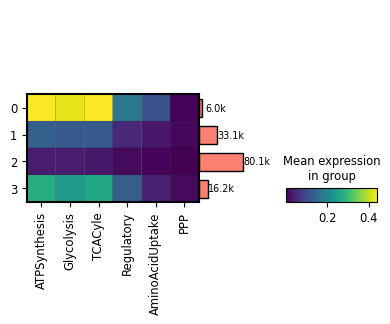

In [78]:
mp = sc.pl.matrixplot(adata, ['ATPSynthesis', 'Glycolysis', 'TCACyle', 'Regulatory', 'AminoAcidUptake', 'PPP'], groupby='MetaPathNeighbourhood', 
                      dendrogram=False, return_fig=True, log=True, standard_scale=False)
mp.add_totals().style(edge_color='black').show()

<Axes: xlabel='MetaPathNeighbourhood'>

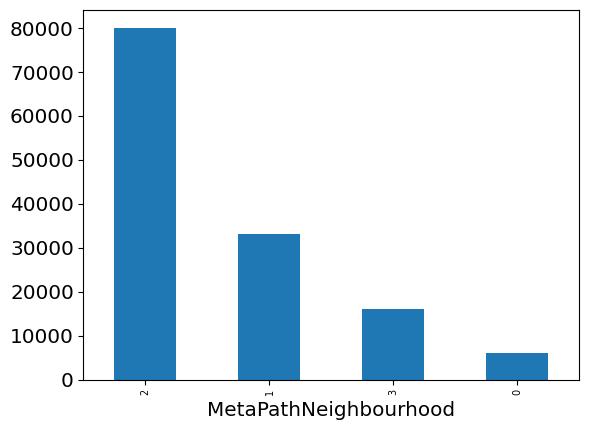

In [101]:
adata.obs['MetaPathNeighbourhood'].value_counts().plot(kind='bar')

## Define the Cellular Neighbourhoods

In [80]:
import spatial_analysis.tools.nolan as nolan
import spatial_analysis.plot.nolan as nolan_plotting

## Tumour/Stroma/Tumour-Stroma Interface

In [87]:
nolan.cellular_neighborhoods(adata,
    grouping="patientid", # The var defining the same coordinate space
    knn=20, # K nearest neighbours to keep track of
    kmeans=3, # How many neighbourhoods to compute
    phenotype='tumournontumour' # Phenotype to compute enrichment scores for
)

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/spatial_analysis/tools/nolan.py:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_groupby = data.groupby(grouping)


Function 'cellular_neighborhoods' executed in 0.9612s


In [88]:
adata.uns['nolan']['cellular_neighborhoods']['enrichment_matrix'][('patientid', 'tumournontumour')][(20, 3)]

,nontumorcells,tumorcells
0,-0.069741,0.098215
1,-2.045103,1.091607
2,0.622974,-2.367370


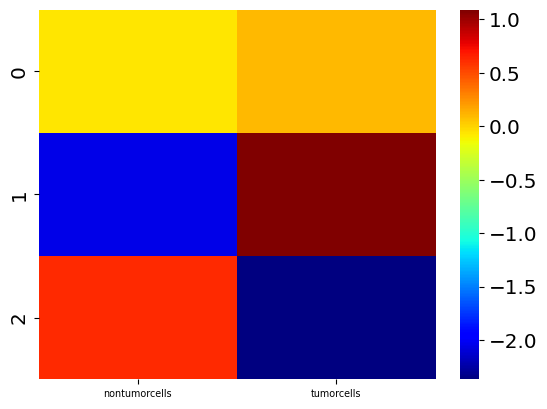

In [89]:
sns.heatmap(adata.uns['nolan']['cellular_neighborhoods']['enrichment_matrix'][('patientid', 'tumournontumour')][(20, 3)], cmap='jet')
plt.show()

In [90]:
from spatial_analysis.tools.nolan import _get_cellular_neighborhoods_labels
from spatial_analysis.tools.nolan import _get_cellular_neighborhoods_enrichment_matrix
 
grouping = "patientid" # or what u have
phenotype = "tumournontumour" # or what u have
k = 20
n = 3
# Assign the neighborhood names
k3ns = {0: 'Tumour_Stroma_interface', 1: 'Tumour', 2: 'Stroma'}
adata.obs[f"nb_{phenotype}_{k}_{n}"] = _get_cellular_neighborhoods_labels(adata, grouping, phenotype, k, n)
adata.obs[f"nb_{phenotype}_{k}_{n}"] = (adata.obs[f"nb_{phenotype}_{k}_{n}"].map(k3ns).astype('category'))
adata.uns[f"nb_{phenotype}_{k}_{n}"] = _get_cellular_neighborhoods_enrichment_matrix(adata, grouping, phenotype, k ,n)
adata.uns[f"nb_{phenotype}_{k}_{n}"].index = _get_cellular_neighborhoods_enrichment_matrix(adata, grouping, phenotype, k ,n).index.map(k3ns)

<Figure size 50x50 with 0 Axes>

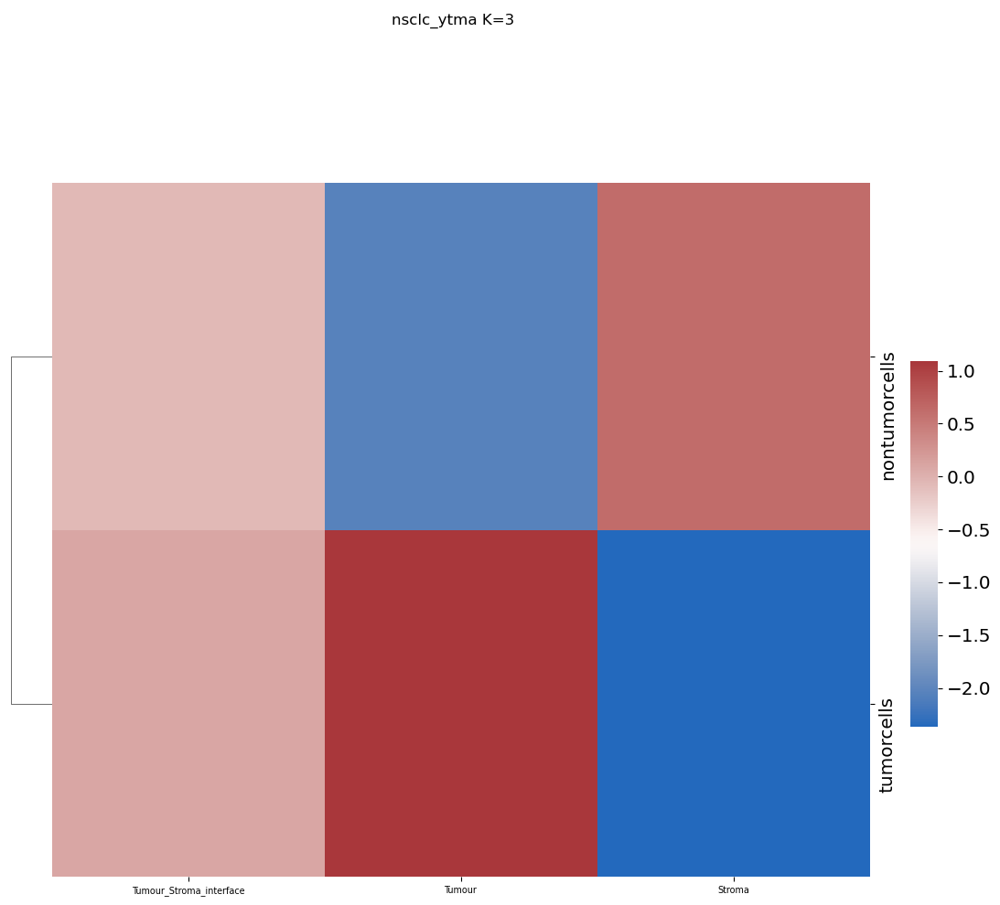

In [91]:
plt.figure(figsize=(0.5,0.5), tight_layout=True)
sns.clustermap(adata.uns['nb_tumournontumour_20_3'].T, row_cluster=True, col_cluster=False, 
                                        cmap='vlag',  cbar_pos=(1, .2, .03, .4),dendrogram_ratio=(.05, .2)#,col_colors =category_colors,
                                       ).fig.suptitle('nsclc_ytma K=3').get_figure()
#plt.savefig('CN_k3types.svg')
plt.show()

## Tumour / Non-Tumour CNs

In [92]:
nolan.cellular_neighborhoods(adata,
    grouping="patientid", # The var defining the same coordinate space
    knn=50, # K nearest neighbours to keep track of
    kmeans=2, # How many neighbourhoods to compute
    phenotype='tumournontumour' # Phenotype to compute enrichment scores for
)

/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/spatial_analysis/tools/nolan.py:128: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  region_groupby = data.groupby(grouping)


Function 'cellular_neighborhoods' executed in 1.2362s


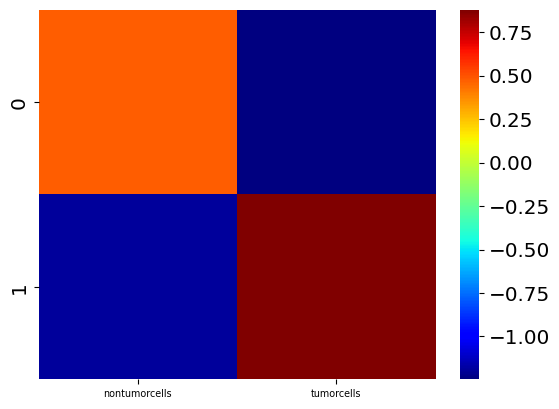

In [93]:
sns.heatmap(adata.uns['nolan']['cellular_neighborhoods']['enrichment_matrix'][('patientid', 'tumournontumour')][(50, 2)], cmap='jet')
plt.show()

In [94]:
grouping = "patientid" # or what u have
phenotype = "tumournontumour" # or what u have
k = 50
n = 2
k2ns = {0: 'Stroma', 1: 'Tumour'}

adata.obs[f"nb_{phenotype}_{k}_{n}"] = _get_cellular_neighborhoods_labels(adata, grouping, phenotype, k, n)
adata.obs[f"nb_{phenotype}_{k}_{n}"] = (adata.obs[f"nb_{phenotype}_{k}_{n}"].map(k2ns).astype('category'))
adata.uns[f"nb_{phenotype}_{k}_{n}"] = _get_cellular_neighborhoods_enrichment_matrix(adata, grouping, phenotype, k, n)
adata.uns[f"nb_{phenotype}_{k}_{n}"].index = _get_cellular_neighborhoods_enrichment_matrix(adata, grouping, phenotype, k, n).index.map(k2ns)

<Figure size 50x50 with 0 Axes>

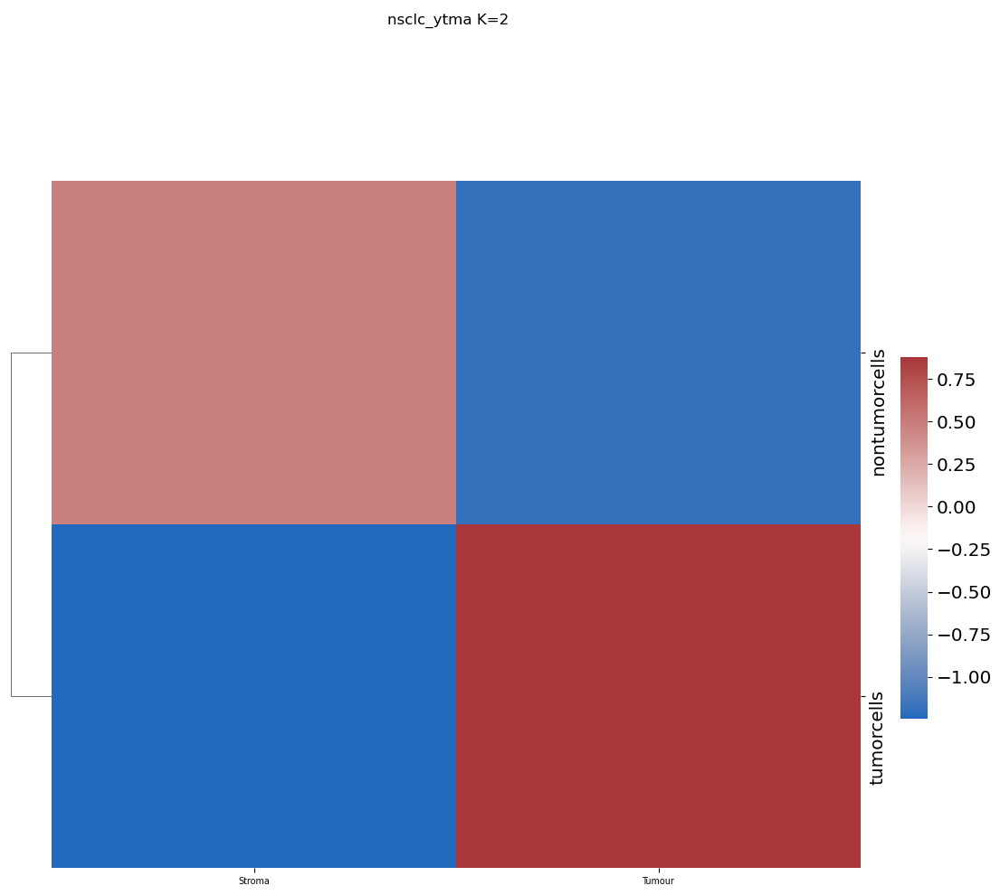

In [95]:
plt.figure(figsize=(0.5,0.5), tight_layout=True)

sns.clustermap(adata.uns['nb_tumournontumour_50_2'].T,row_cluster=True, col_cluster=False, 
                                        cmap='vlag',  cbar_pos=(1, .2, .03, .4),dendrogram_ratio=(.05, .2)#,col_colors =category_colors,
                                       ).fig.suptitle('nsclc_ytma K=2').get_figure()
#plt.savefig('CN_k2types.svg')
plt.show()

## Final fixes before output

In [96]:
# Remove NaNs from marker positivity
colsToConvert = [col for col in adata.obsm['marker_positivity'].columns if '_prob' not in col]
adata.obsm['marker_positivity'][colsToConvert] = adata.obsm['marker_positivity'][colsToConvert].fillna(0.0).astype(bool).astype(int)
adata.obsm['marker_positivity']

,asct2,asct2high,atpa5,atpa5high,cd11b,cd11c,cd14,cd163,cd19,cd20,...,pax5_prob,pd1_prob,pdl1_prob,pdl1high_prob,pnrf2_prob,pnrf2high_prob,sdha_prob,sdhahigh_prob,sma_prob,vimentin_prob
0,0,0,1,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.00,0.00,0.26,0.00,0.00,0.00
1,0,0,1,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.00,0.00,0.67,0.00,0.00,0.00
2,1,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00
3,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.15,0.00,0.03,0.00,0.00,0.08
4,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.50,0.00,0.01,0.00,0.00,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135341,0,0,1,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.11,0.00,0.10,0.00,0.00,0.87
135342,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.08
135343,0,0,1,0,0,0,0,1,0,0,...,0.0,0.0,0.0,0.0,0.02,0.01,0.05,0.00,0.01,0.81
135344,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.00,0.00,0.01,0.00,0.00,0.43


In [97]:
uns = ['nolan', 'nb_tumournontumour_20_3', 'nb_tumournontumour_50_2',
       'nsclc_frac_features', 'nsclc_neighbour_features']
for un in uns:
    del adata.uns[un]

In [98]:
adata

AnnData object with n_obs × n_vars = 135346 × 44
    obs: 'slideid', 'uuid', 'x', 'y', 'celltypes', 'newcelltypes', 'clusterid', 'neighborhoods', 'arearegion', 'Unnamed: 0', 'inclusion', 'patientid', 'filename', 'cohort', 'tumortype', 'prepost', 'histologytype', 'biopsysite', 'BOR', 'OR', 'CB6', 'PORvsFPD', 'pfs.T', 'pfs.E', 'os.T', 'os.E', 'pfs.6months', 'pfs.12months', 'OS.18months', 'OS.24months', 'Tissue', 'tumournontumour', 'Immune_func', 'Immune_meta', 'tumour_meta', 'tumour_func', 'cell_types_immune_metapath', 'ATPSynthesis', 'Glycolysis', 'TCACyle', 'Regulatory', 'AminoAcidUptake', 'FatOxidation', 'PPP', 'MetaPathNeighbourhood', 'nb_tumournontumour_20_3', 'nb_tumournontumour_50_2'
    uns: 'spatial_neighbors'
    obsm: 'marker_positivity', 'spatial', 'nolan_cellular_neighborhoods_input_X'
    obsp: 'spatial_connectivities', 'spatial_distances'

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

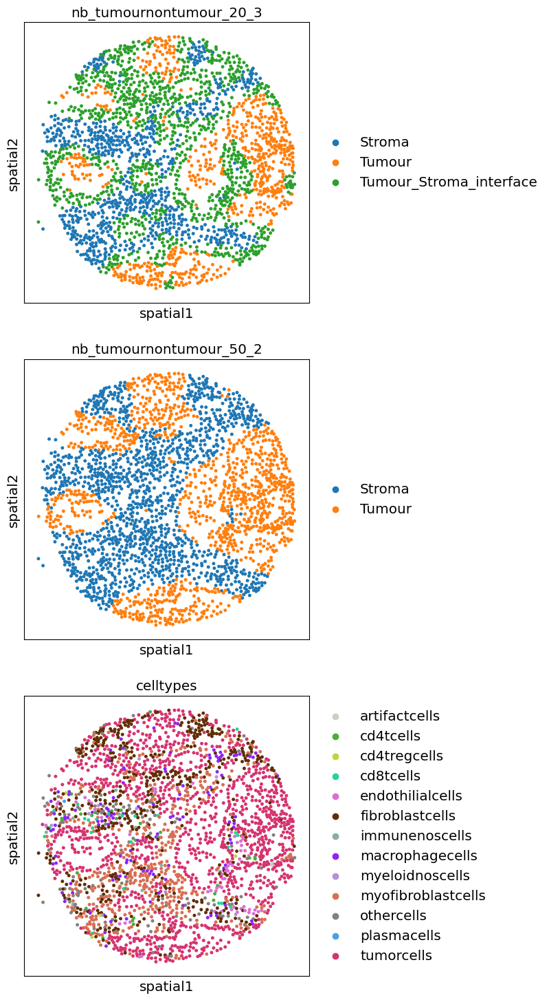

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

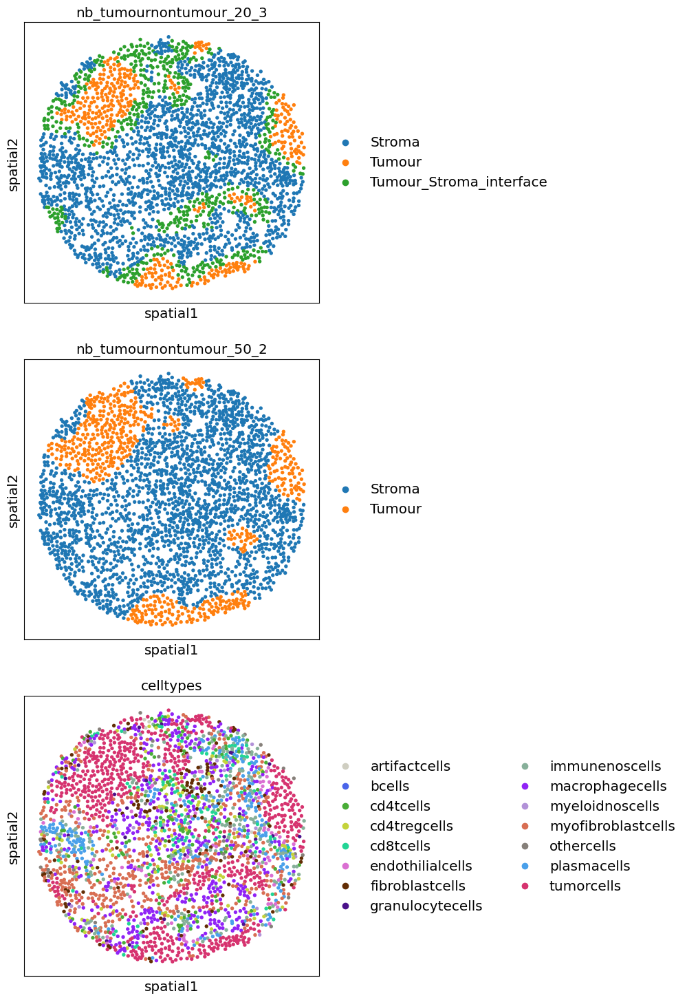

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

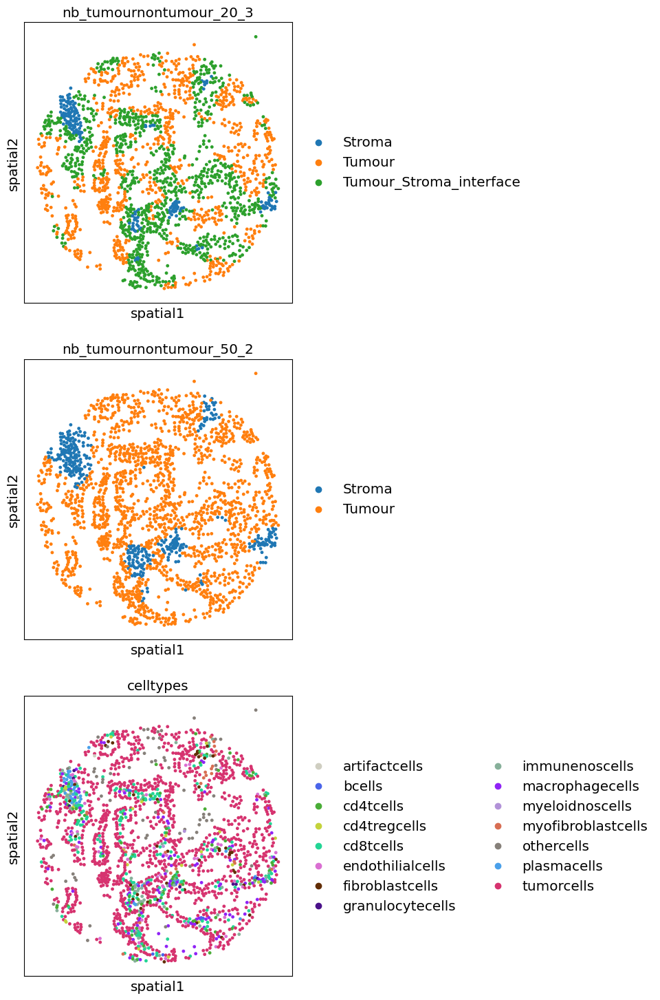

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

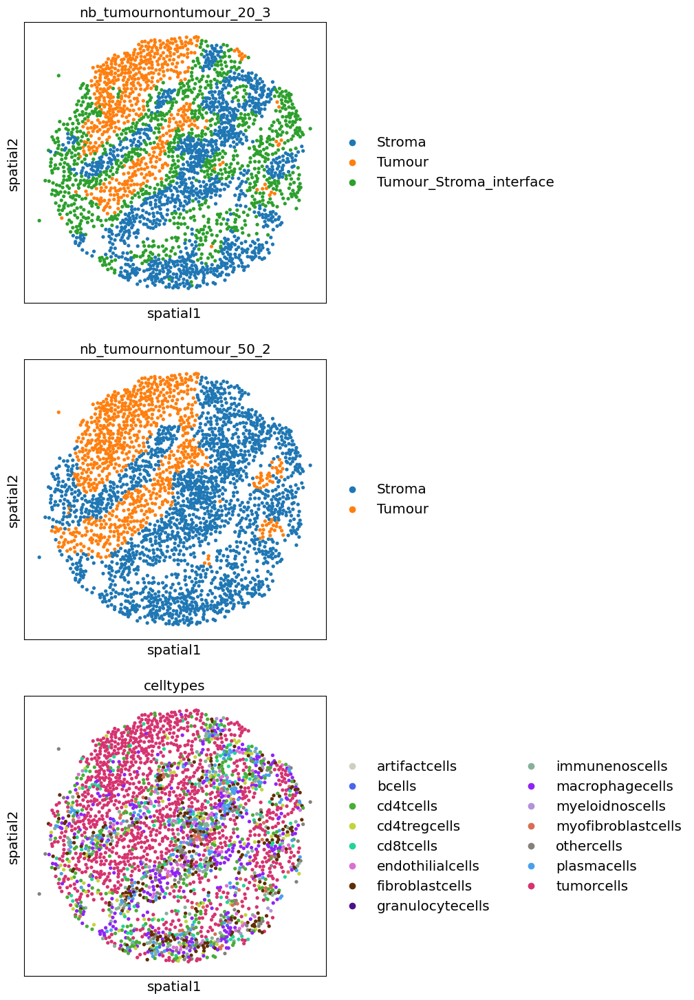

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

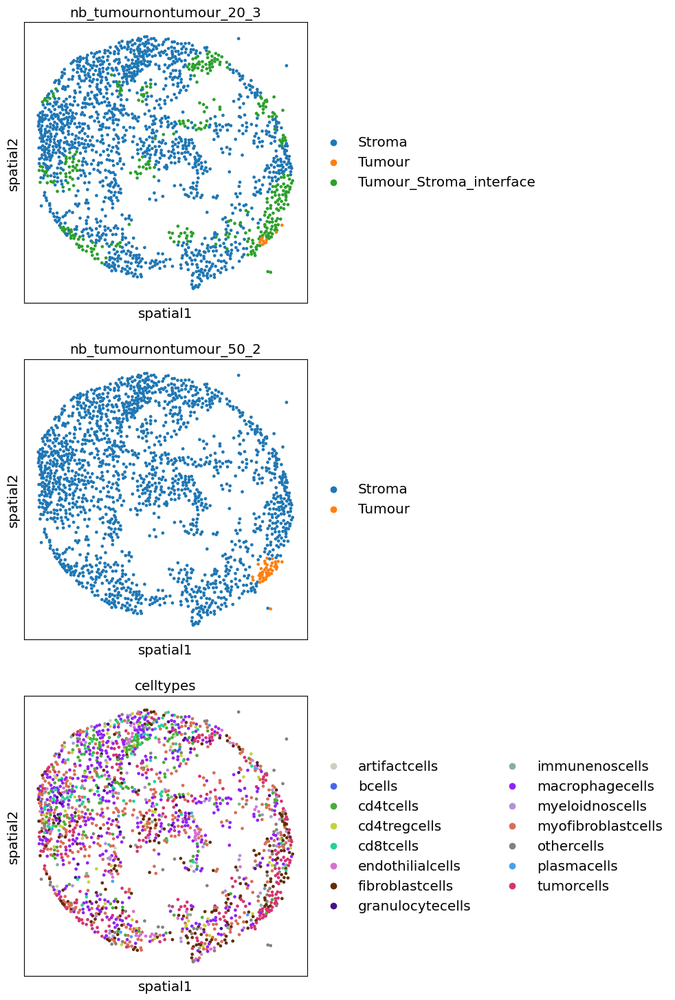

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

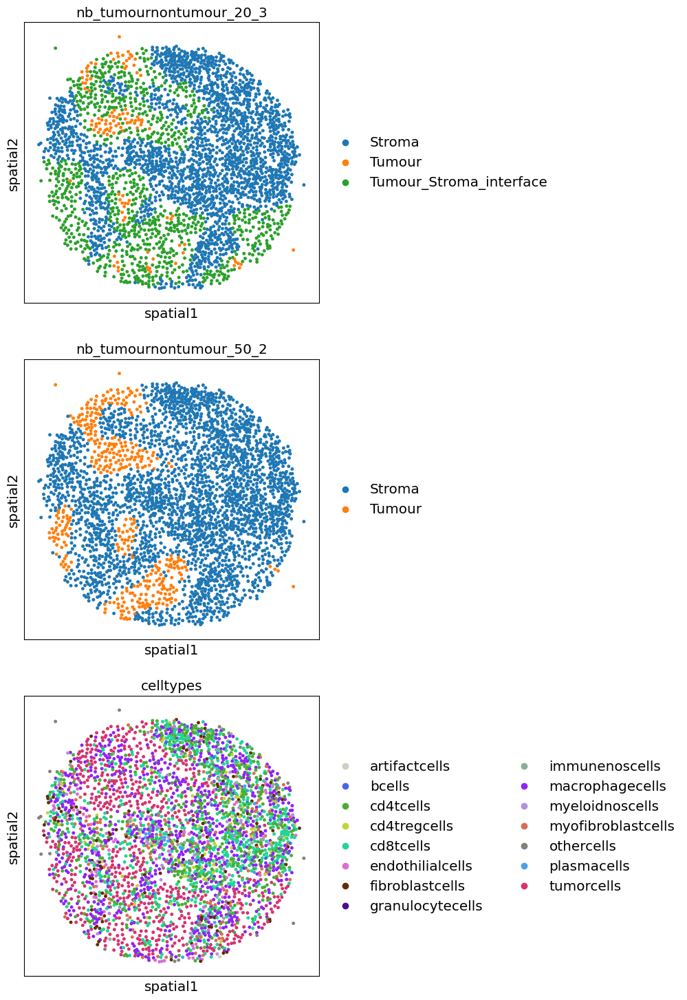

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

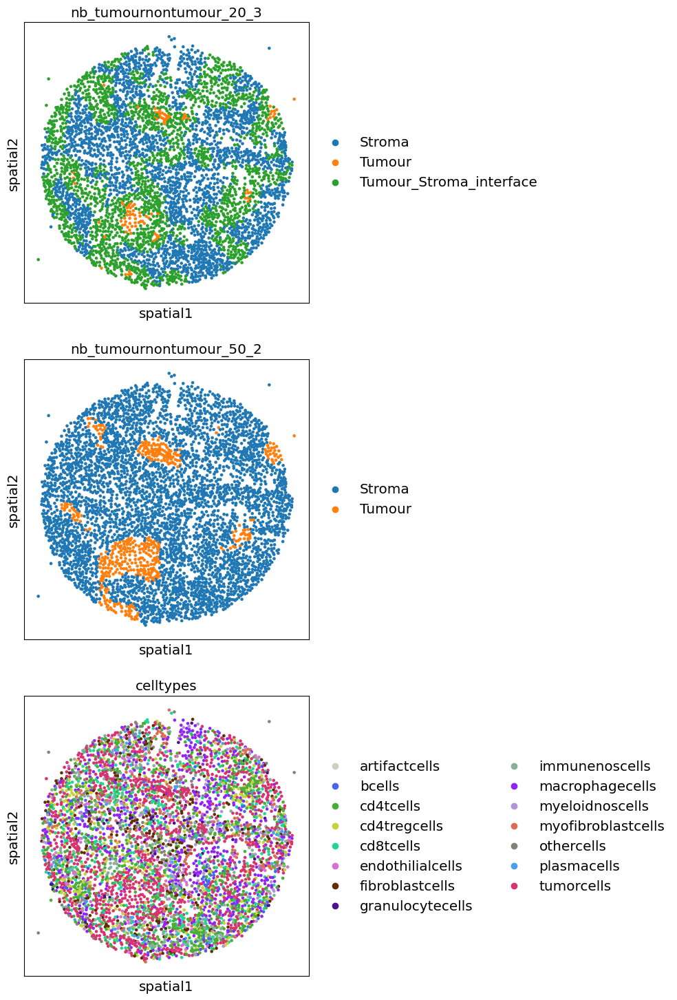

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

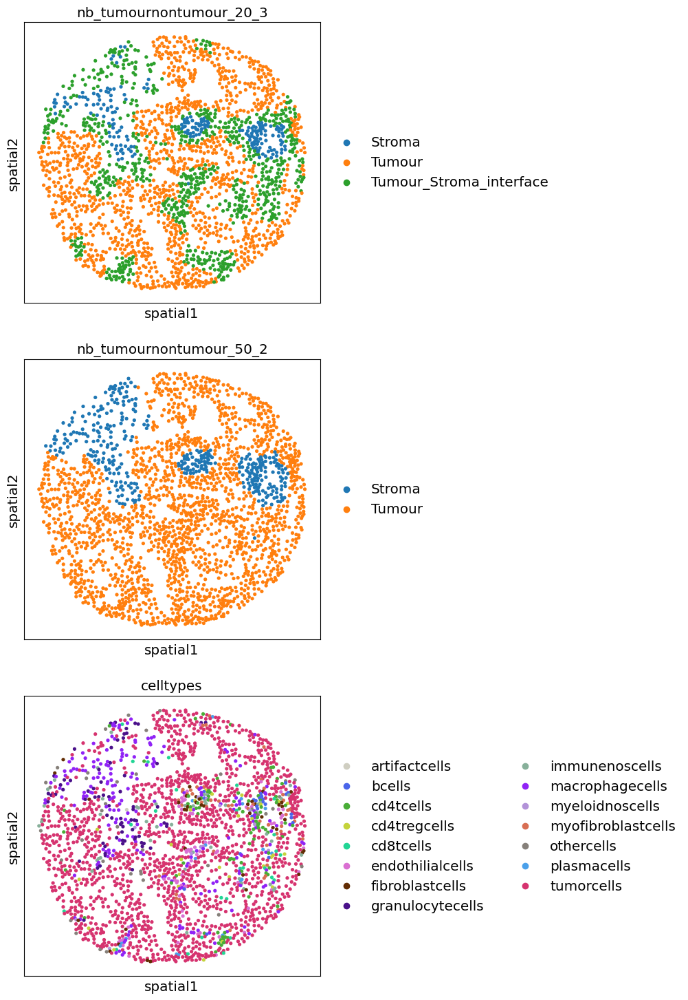

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

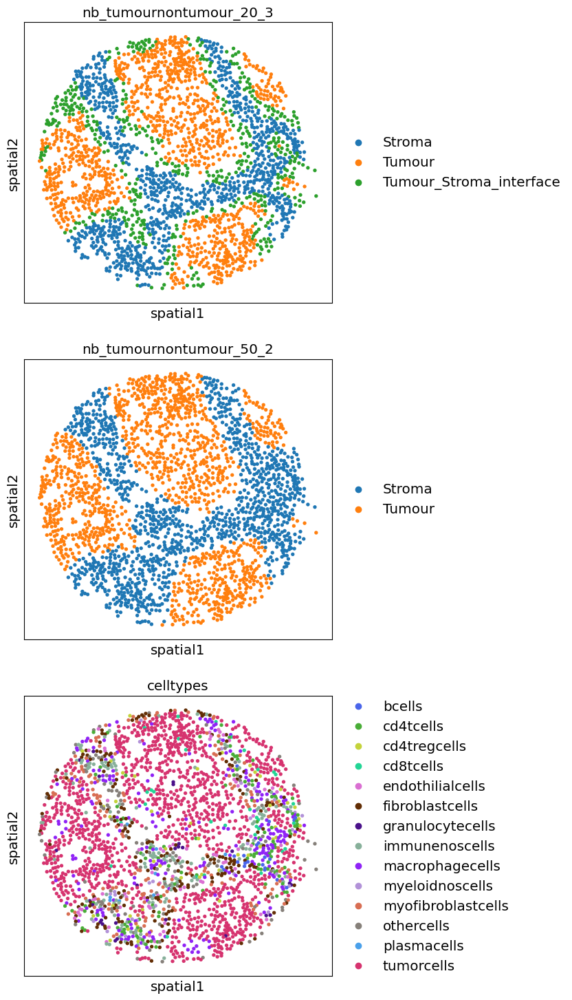

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

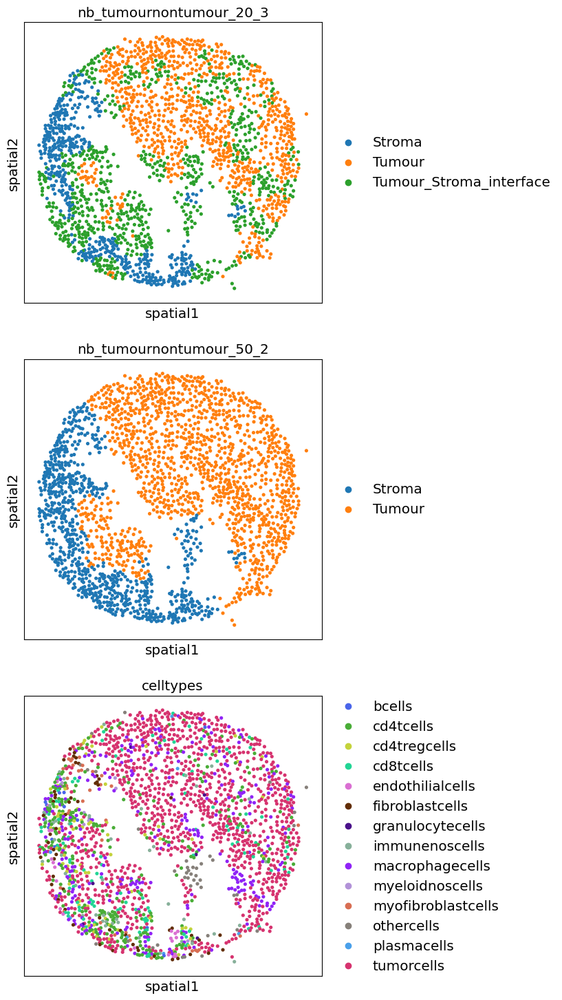

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

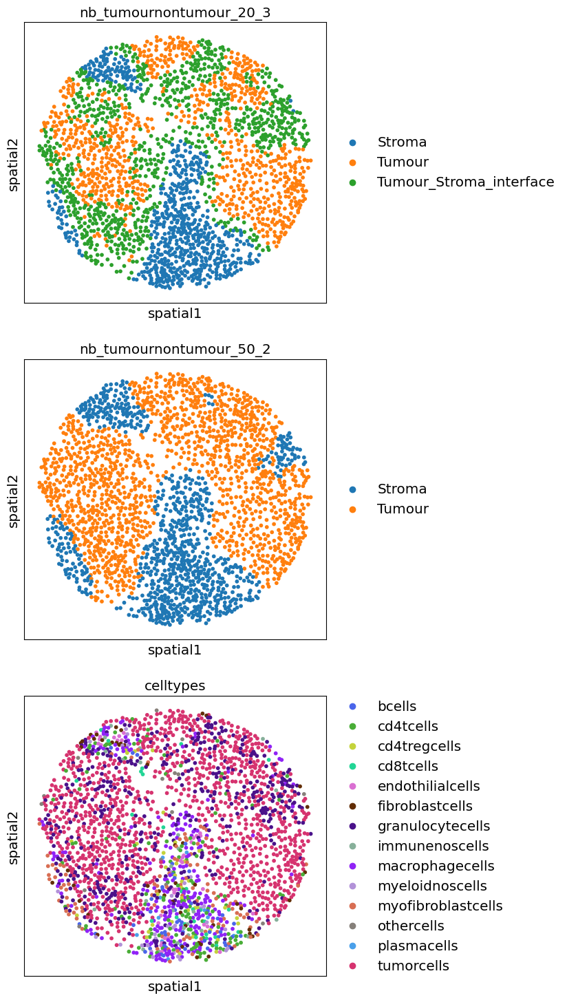

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

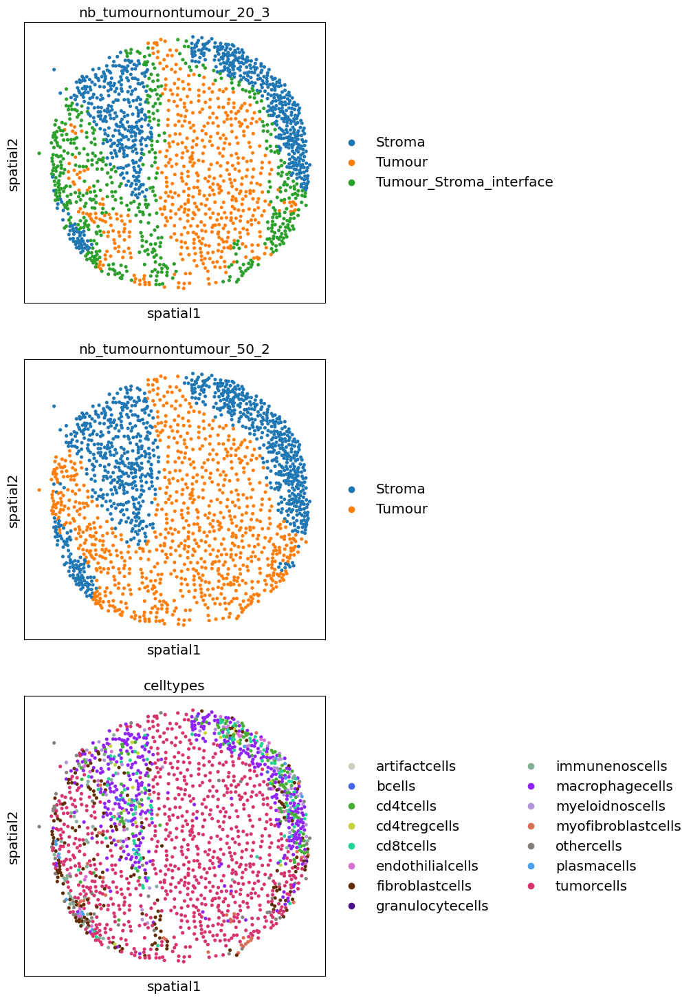

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

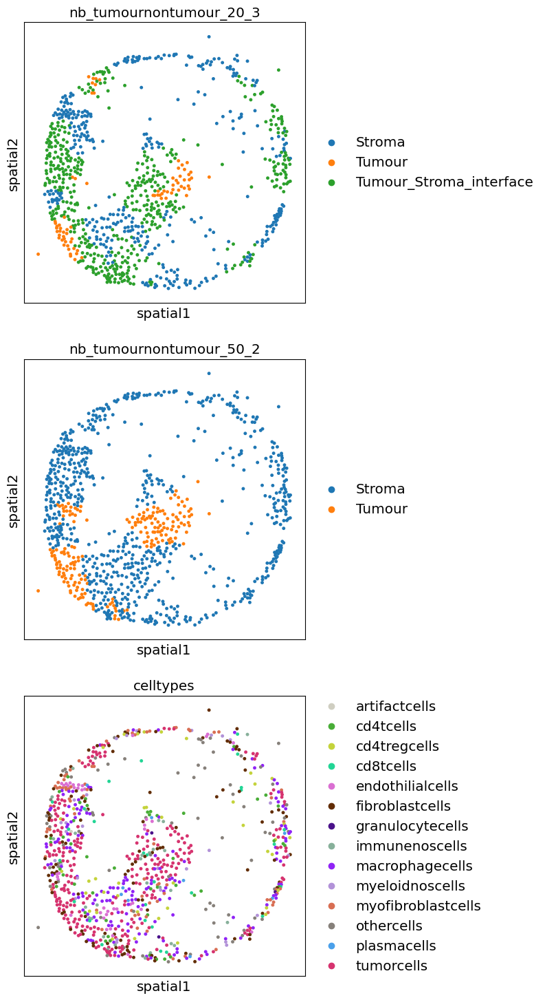

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

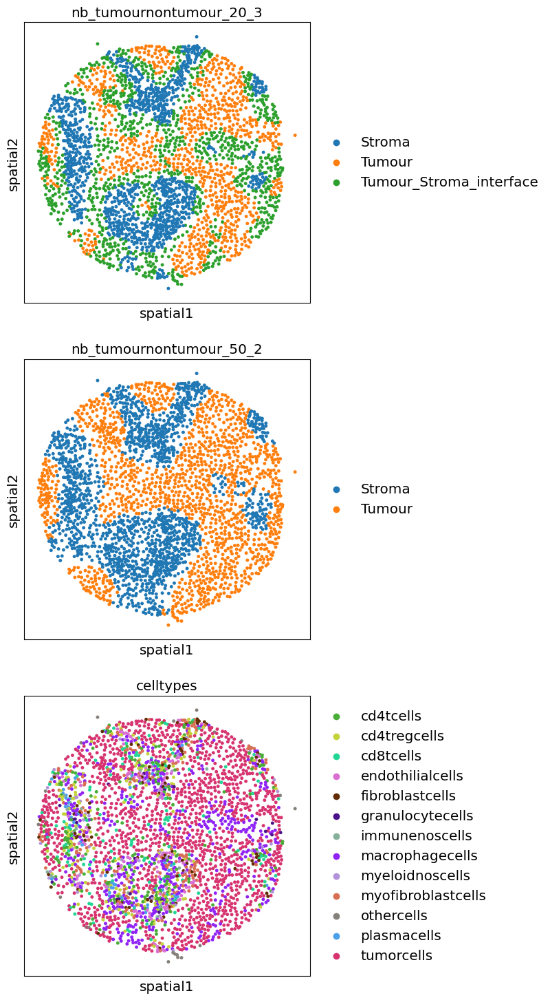

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

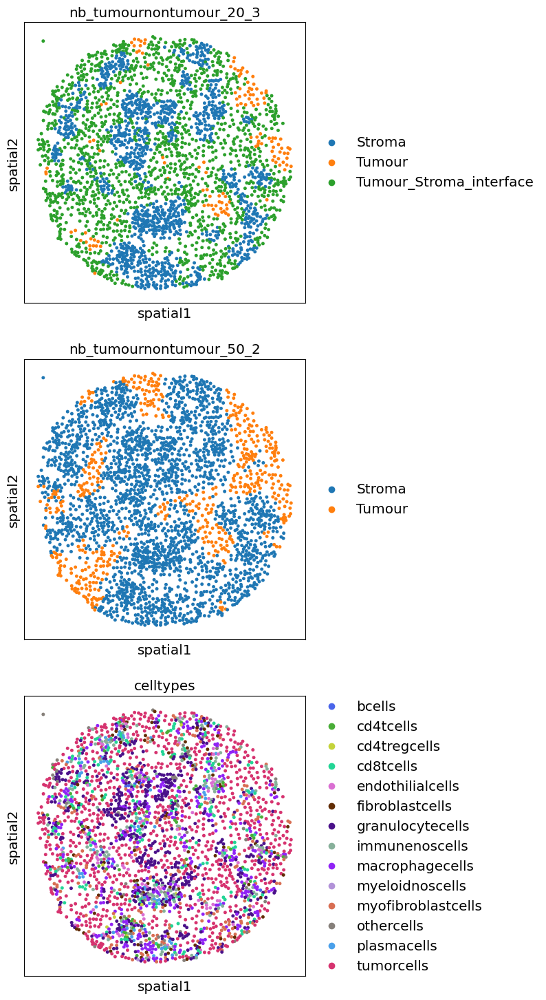

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

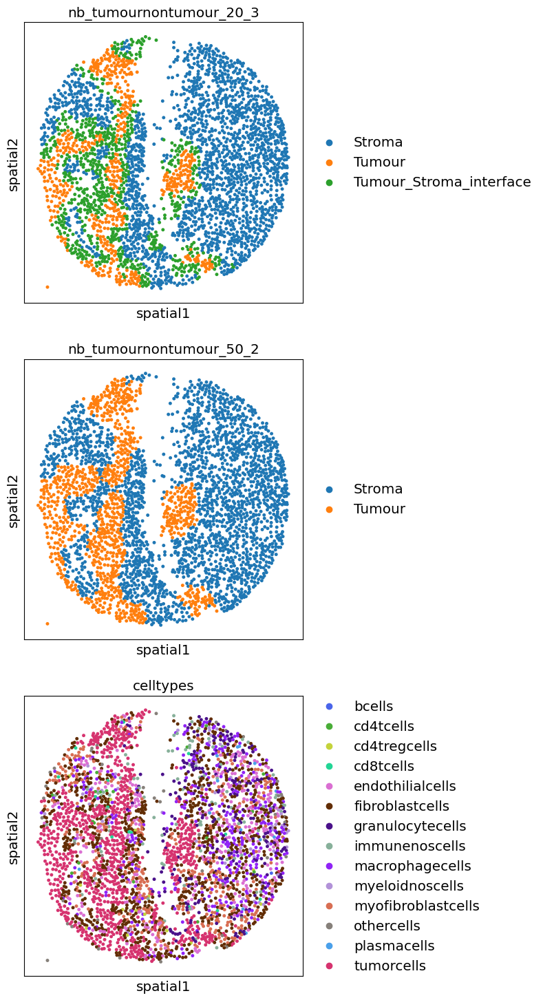

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

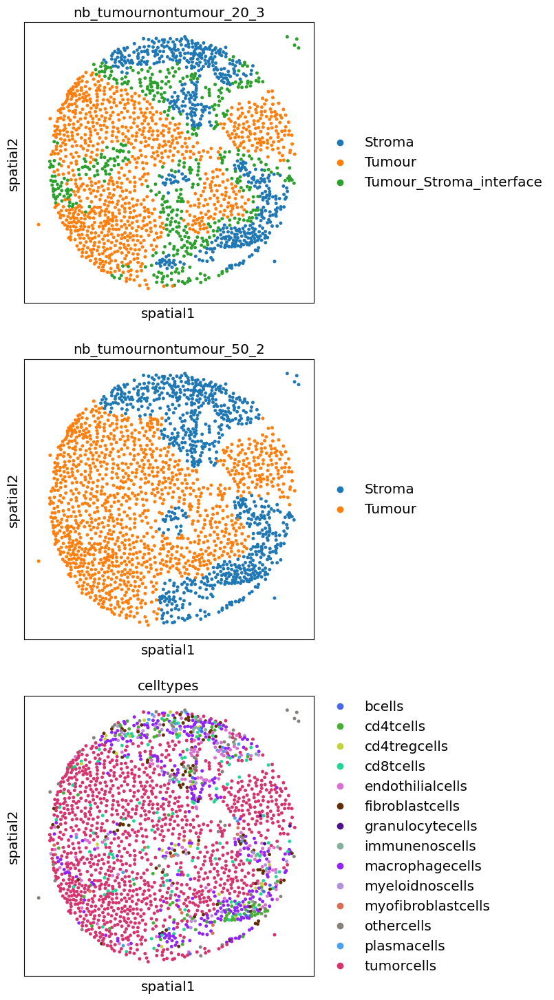

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

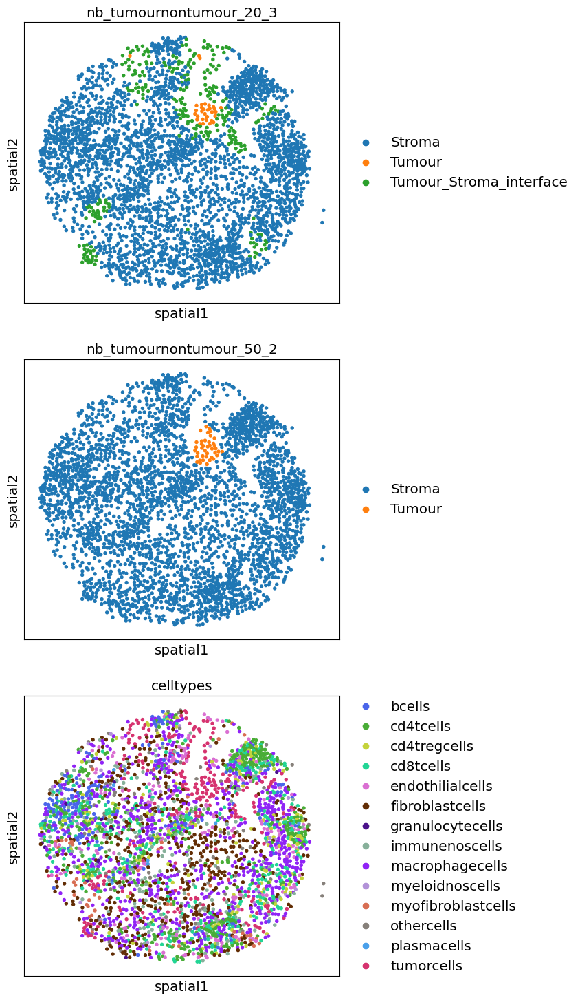

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

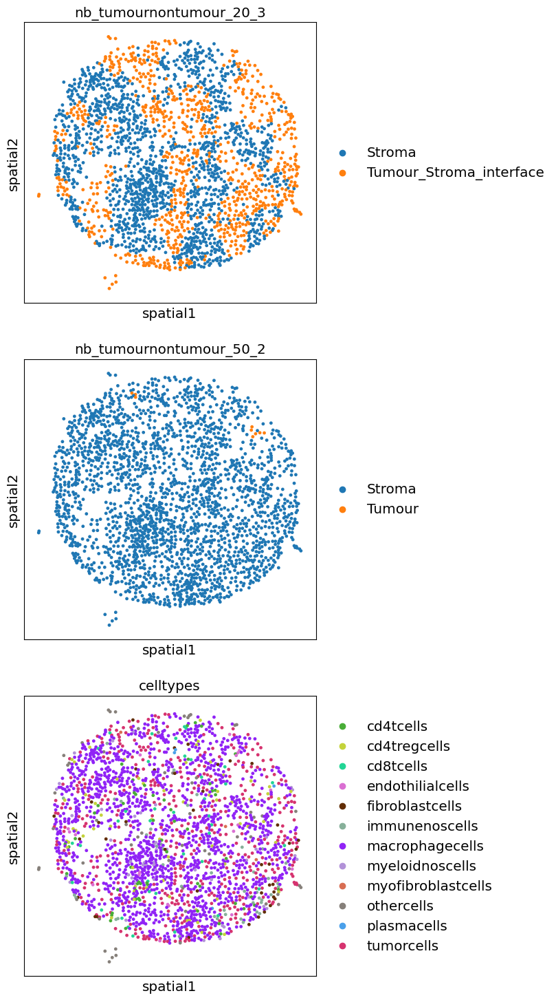

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

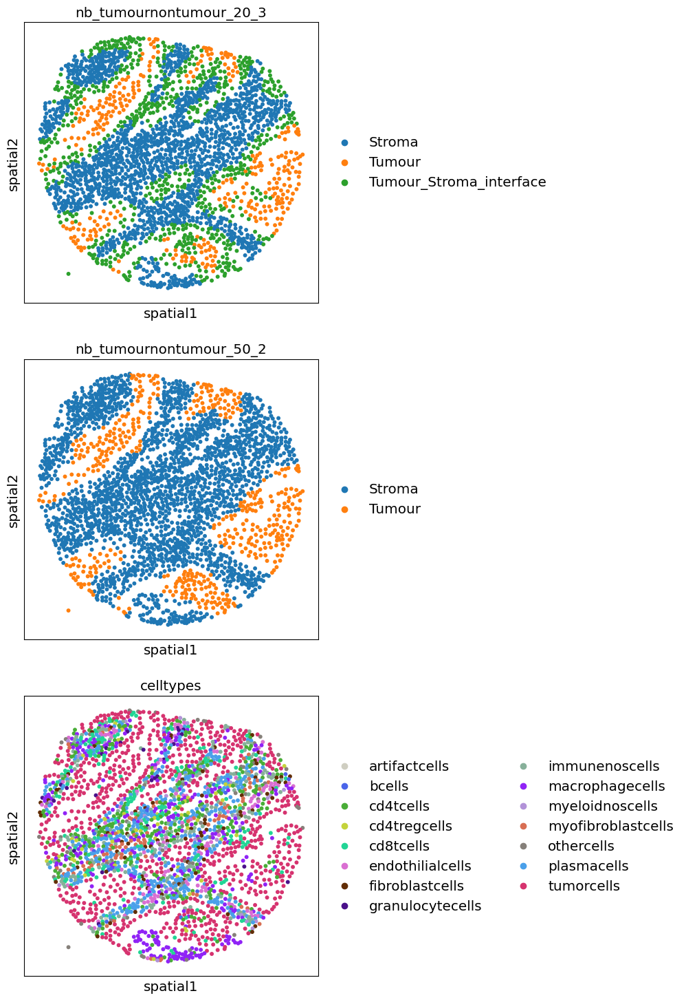

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

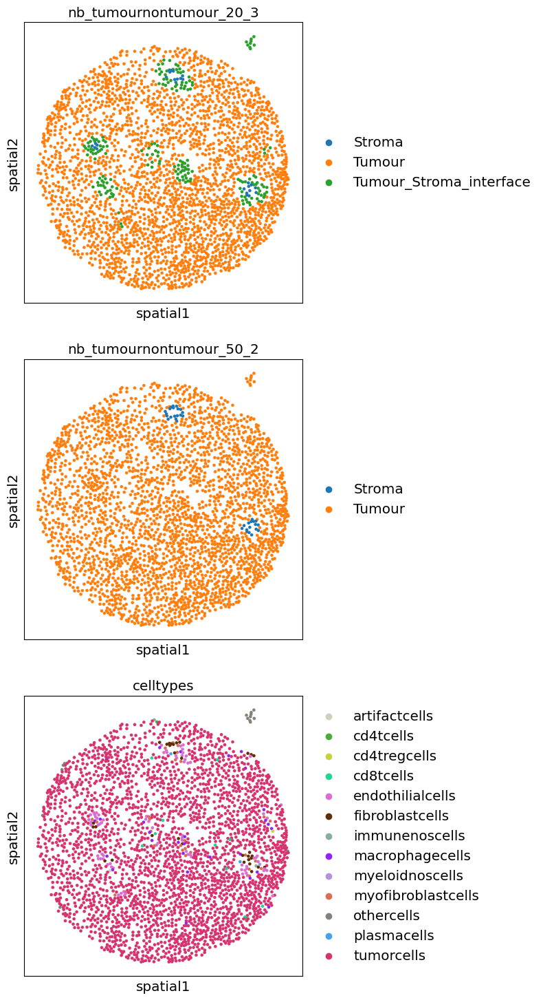

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

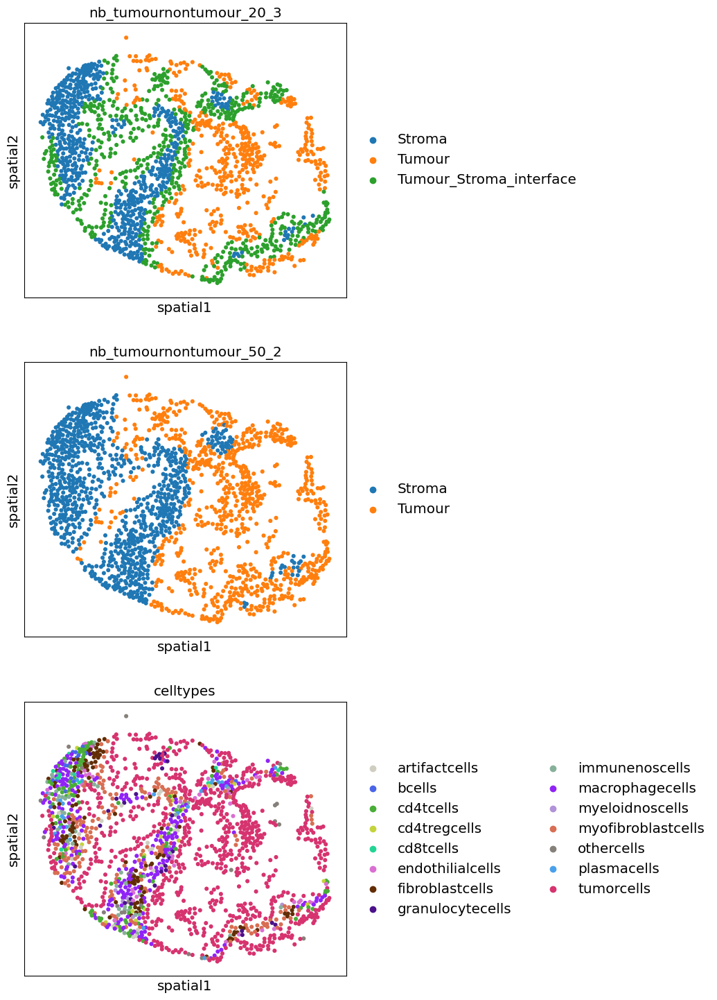

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

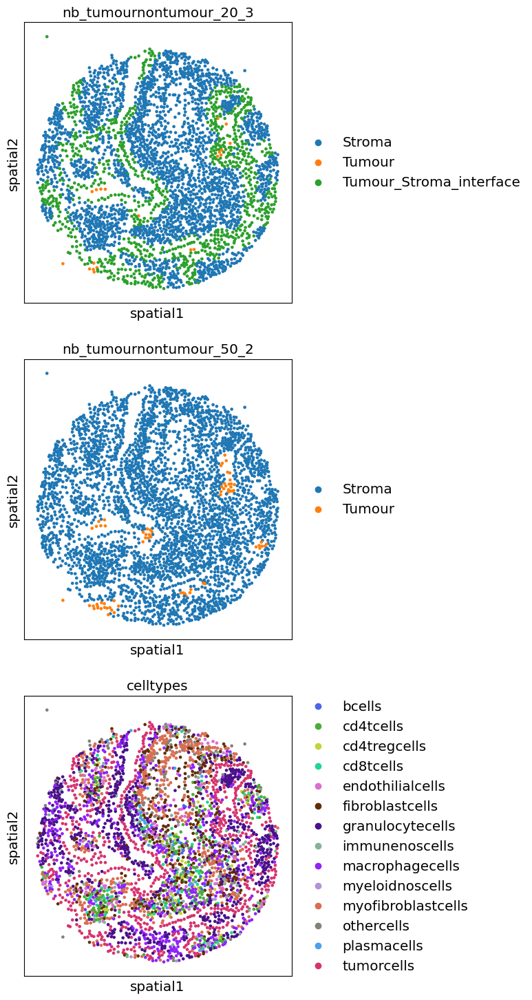

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

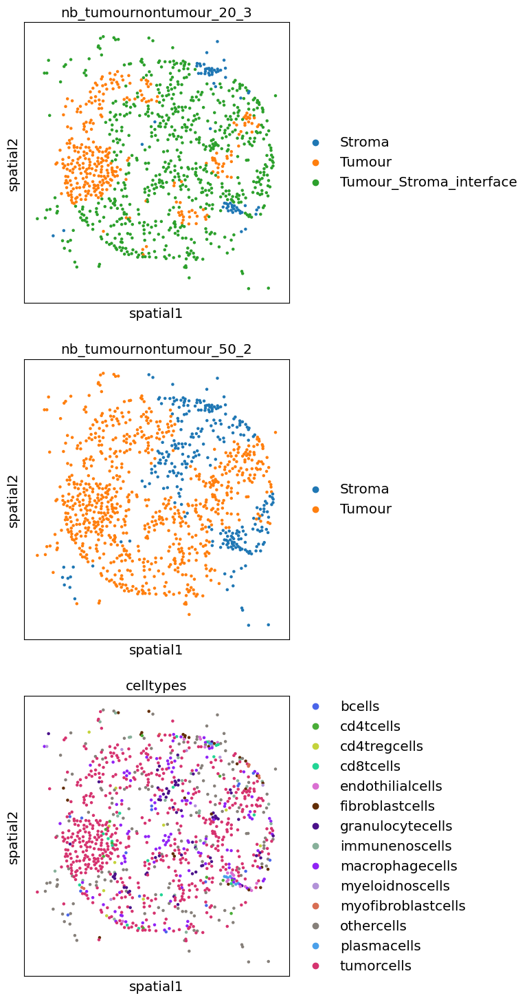

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

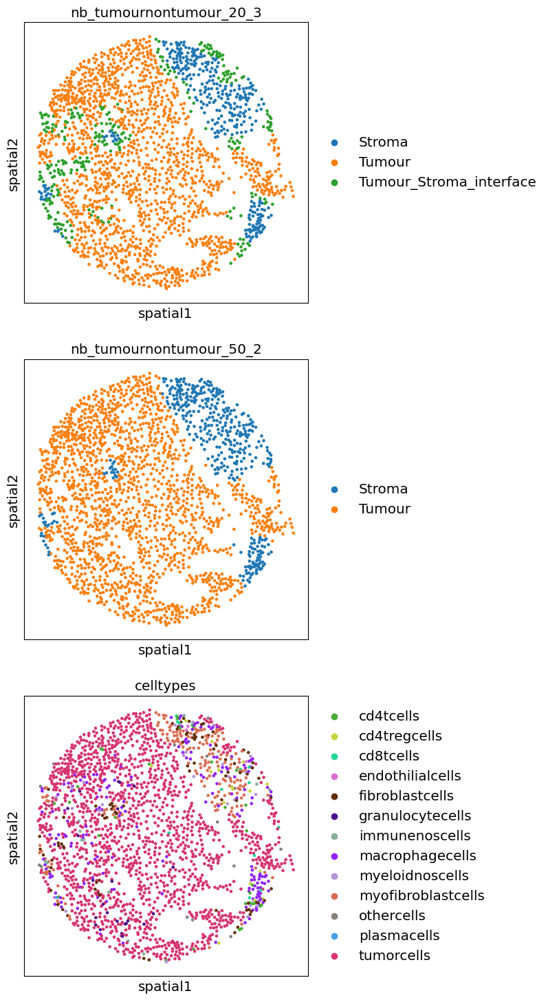

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

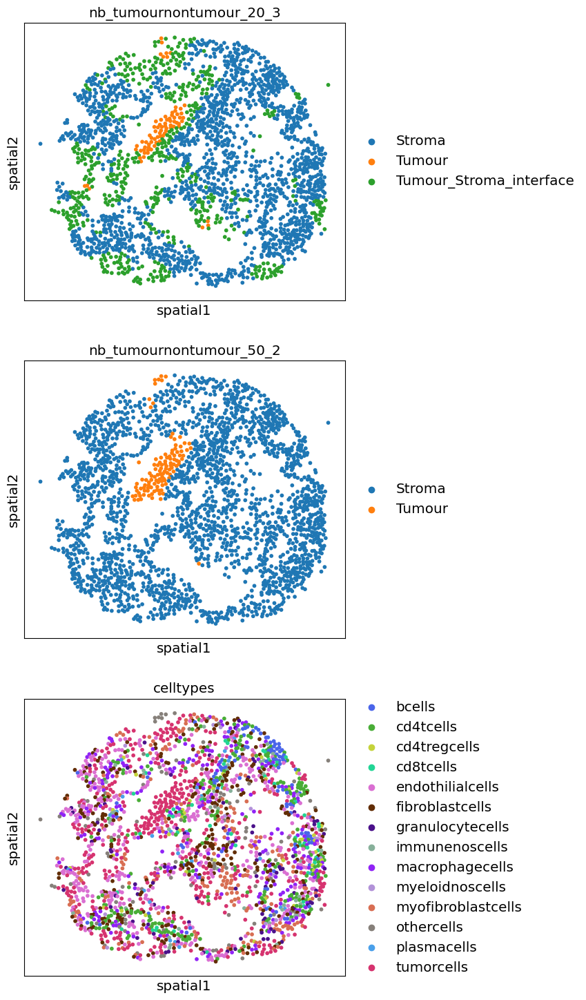

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

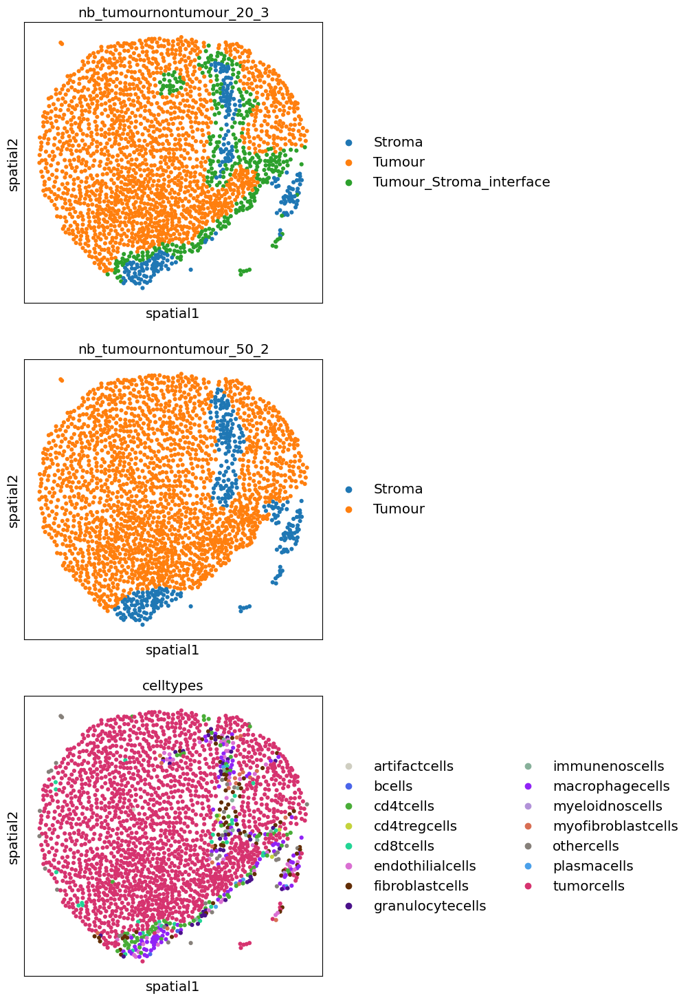

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

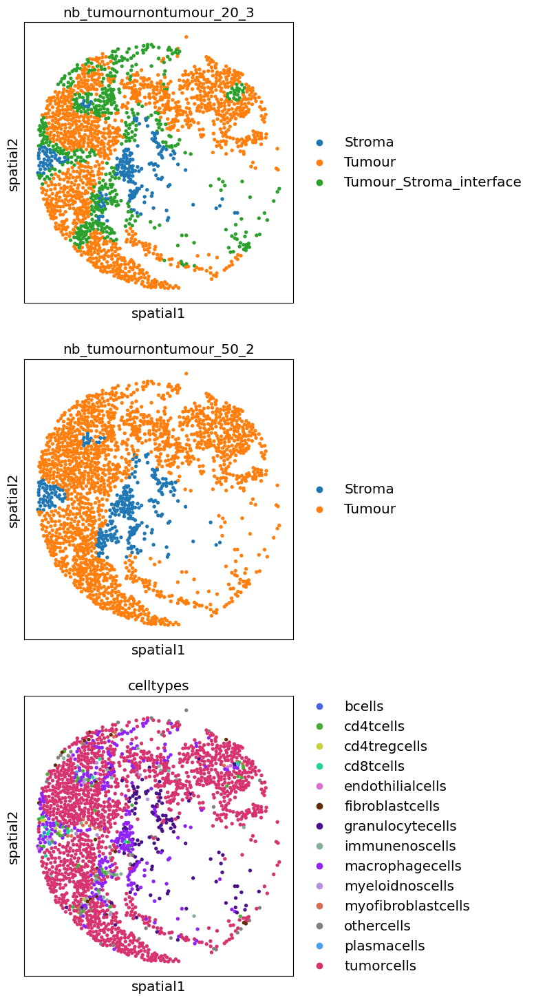

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

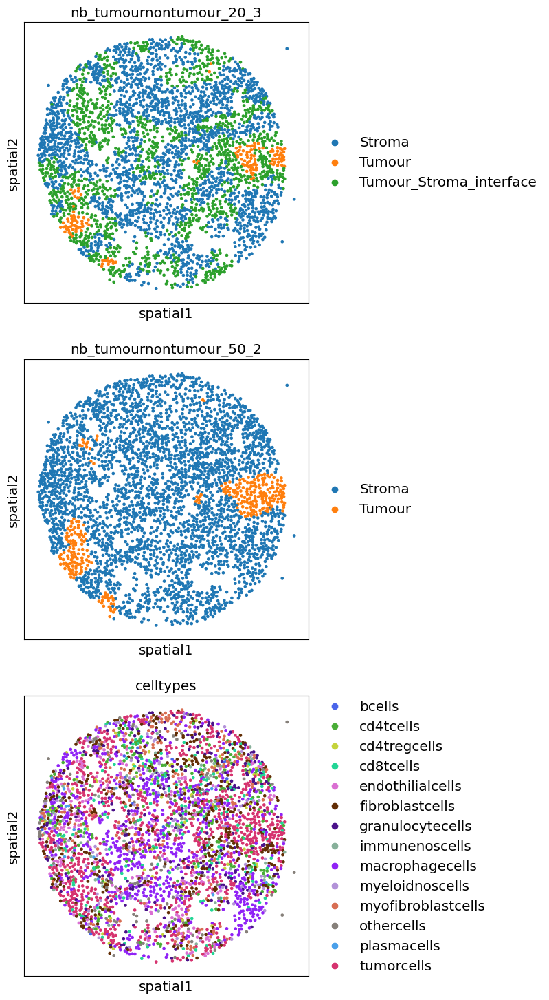

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

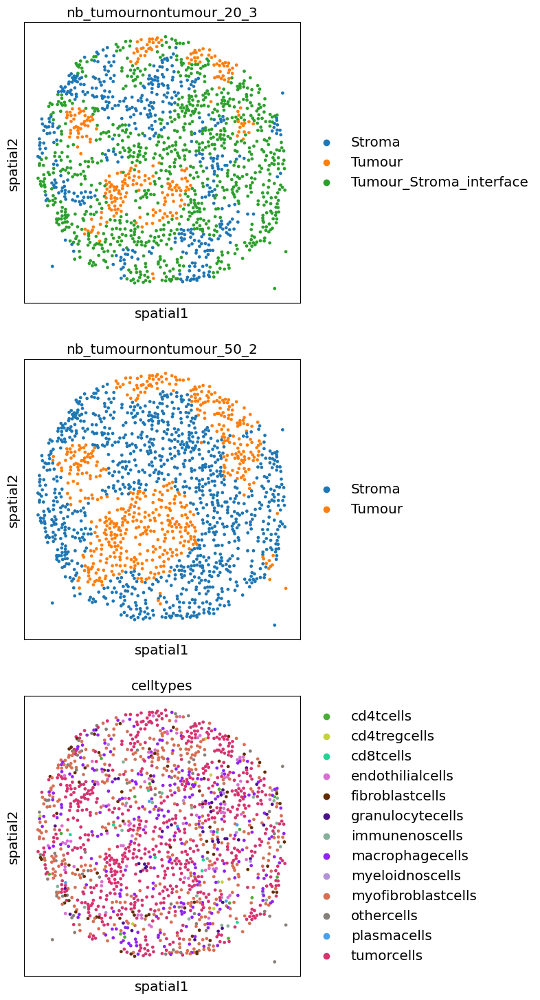

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

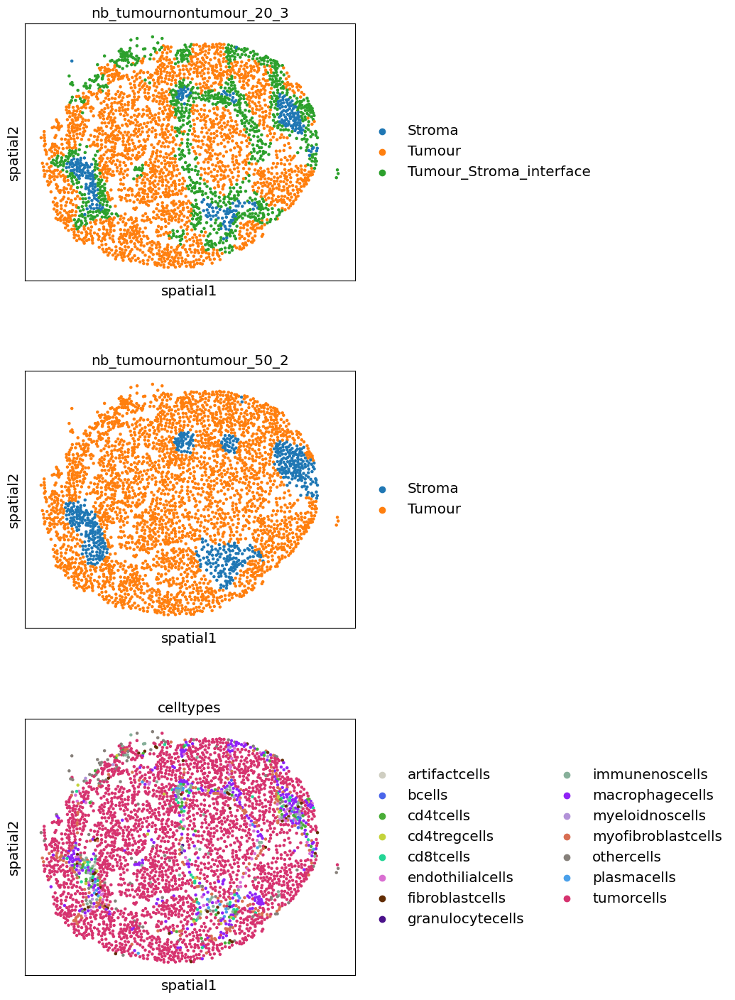

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

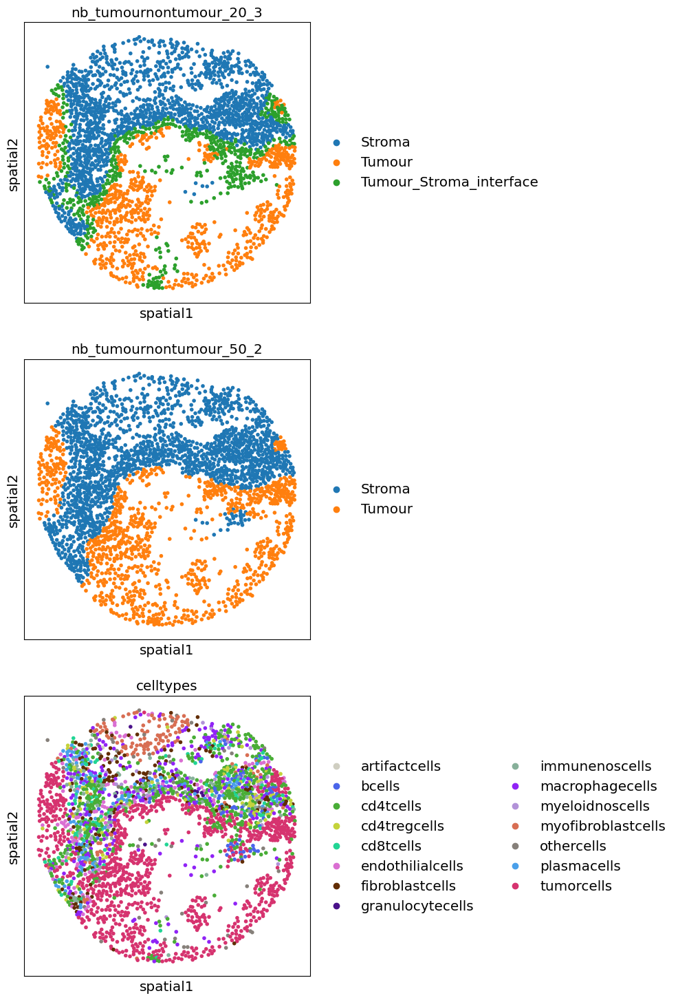

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

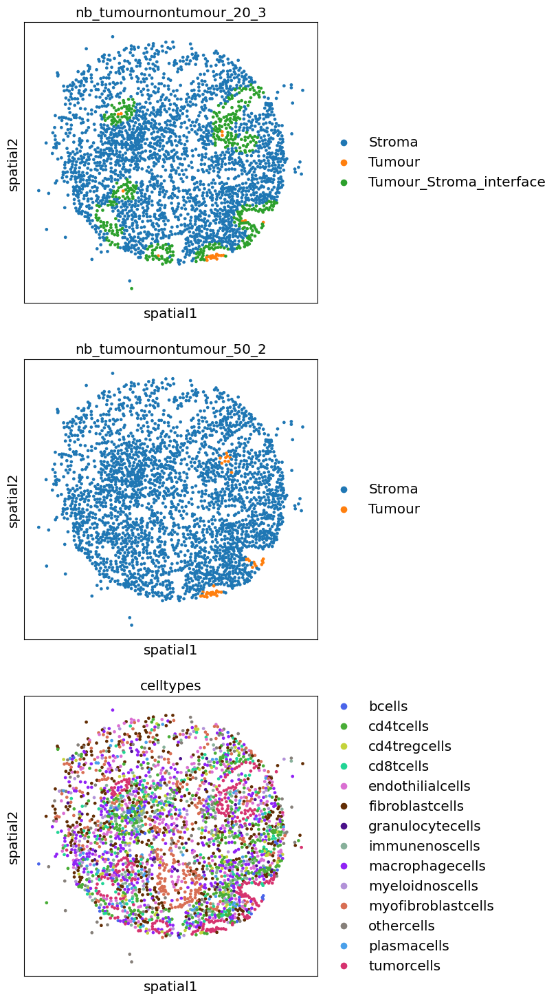

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

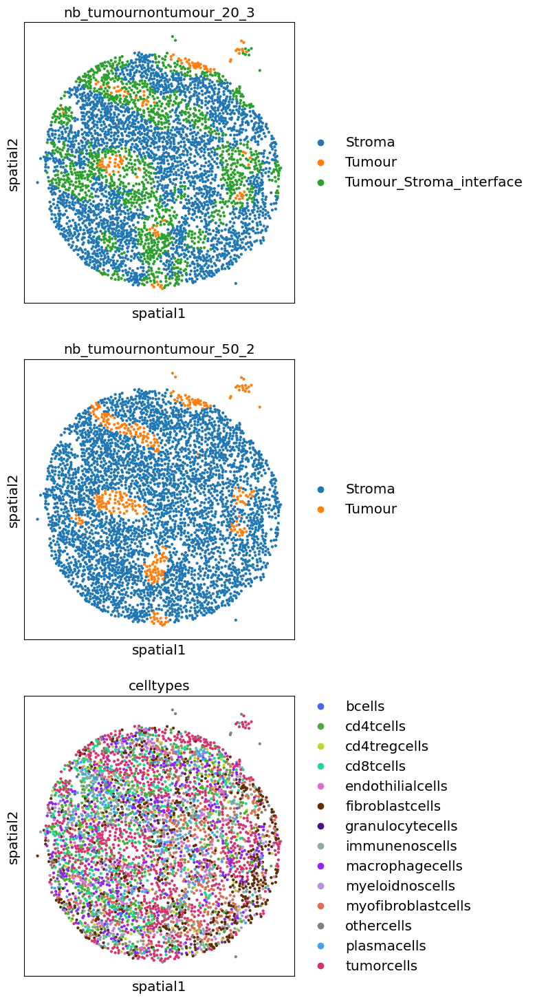

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

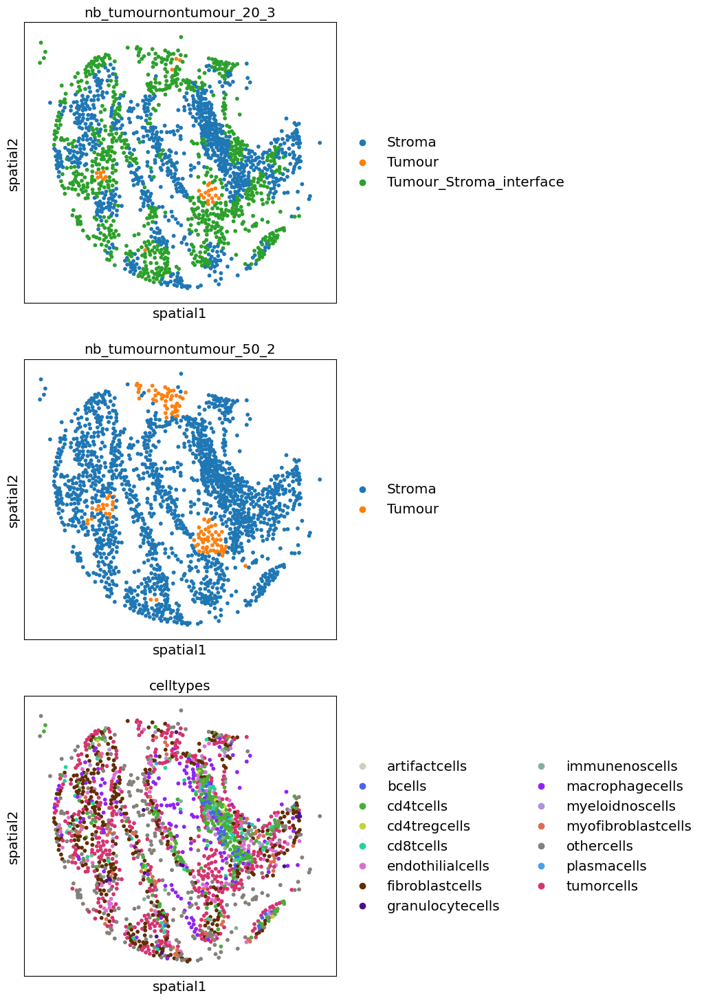

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

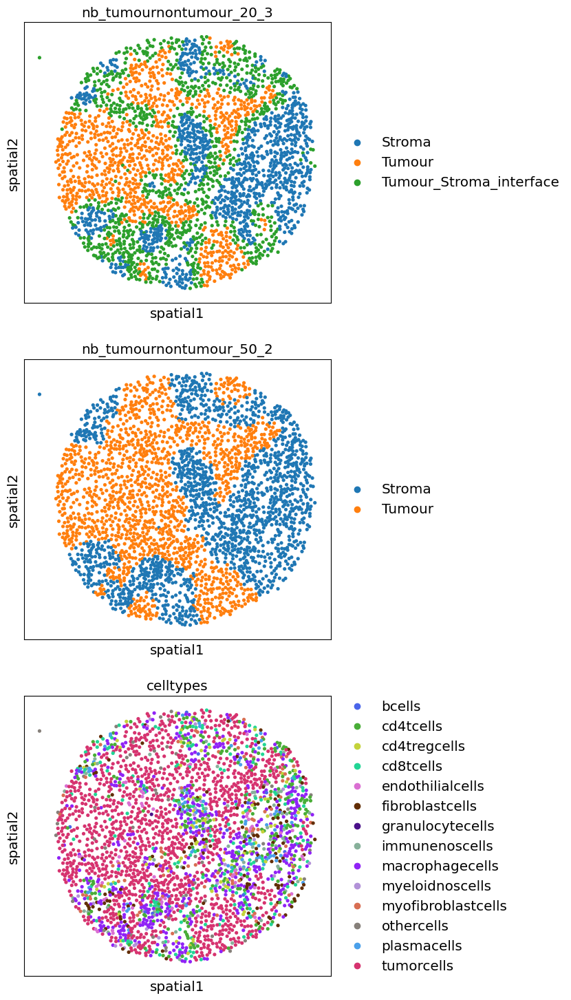

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

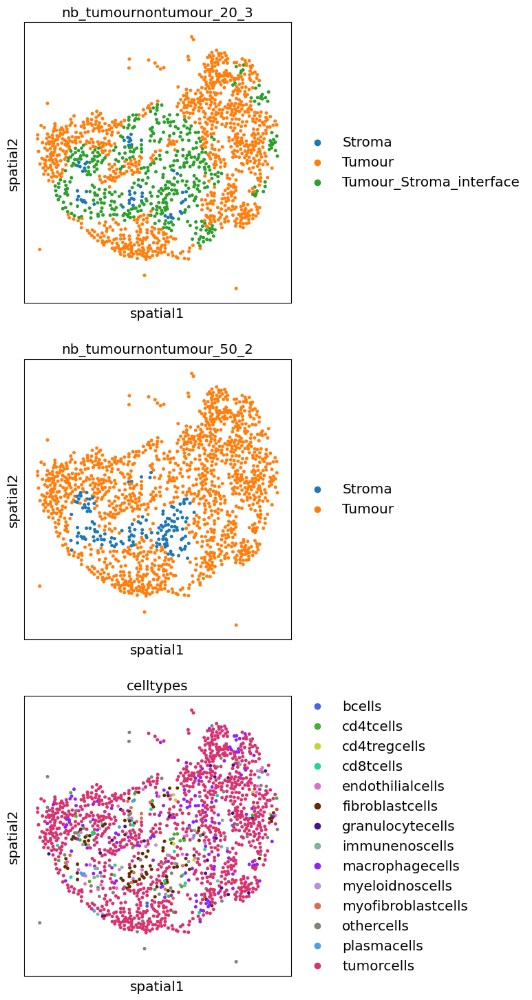

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

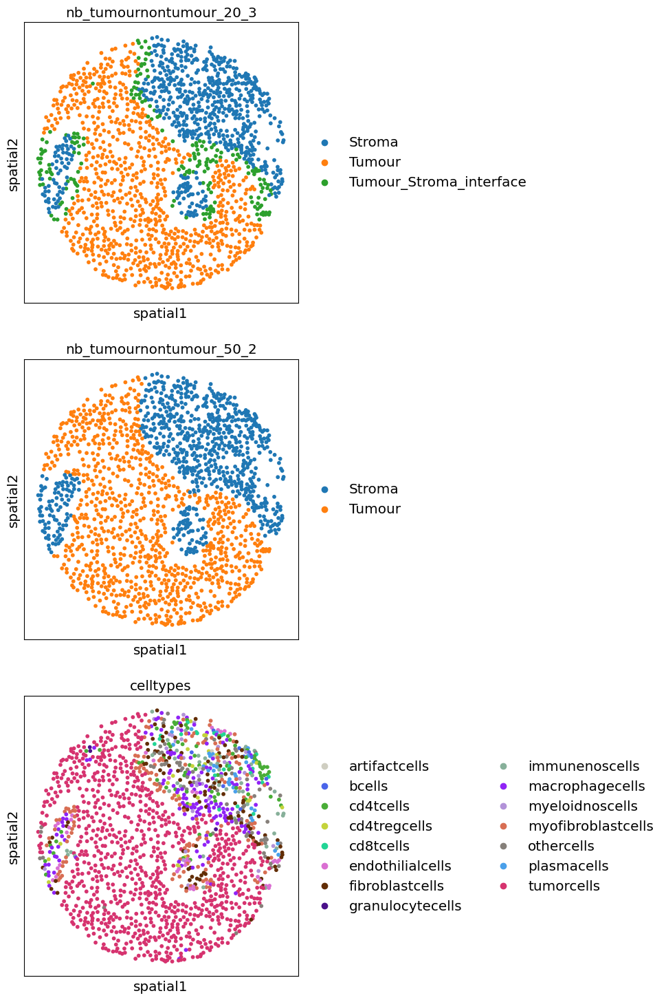

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

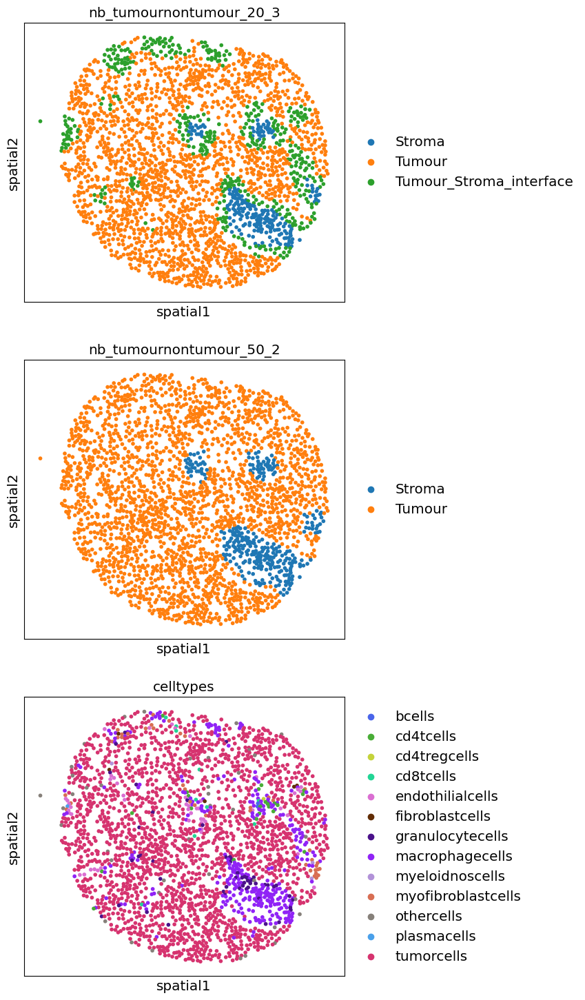

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

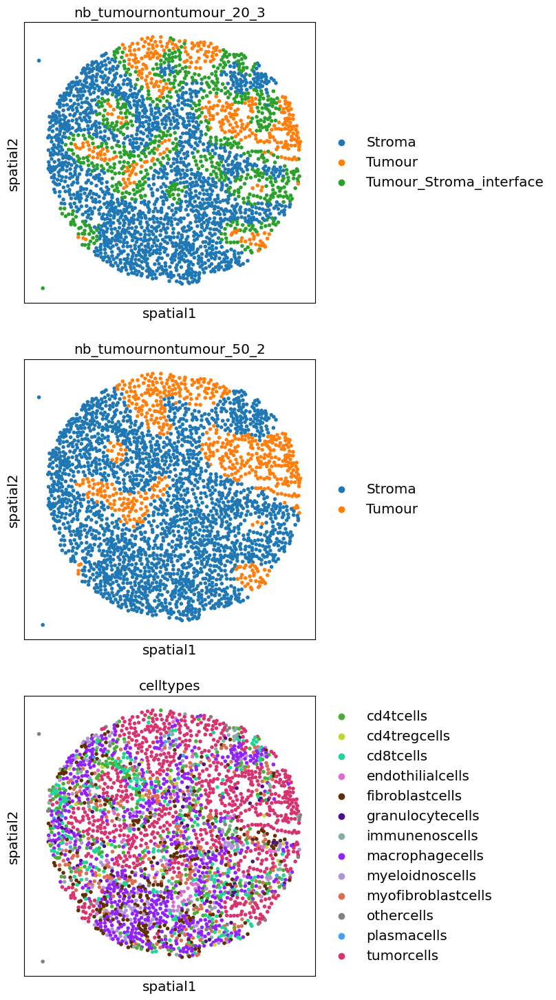

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

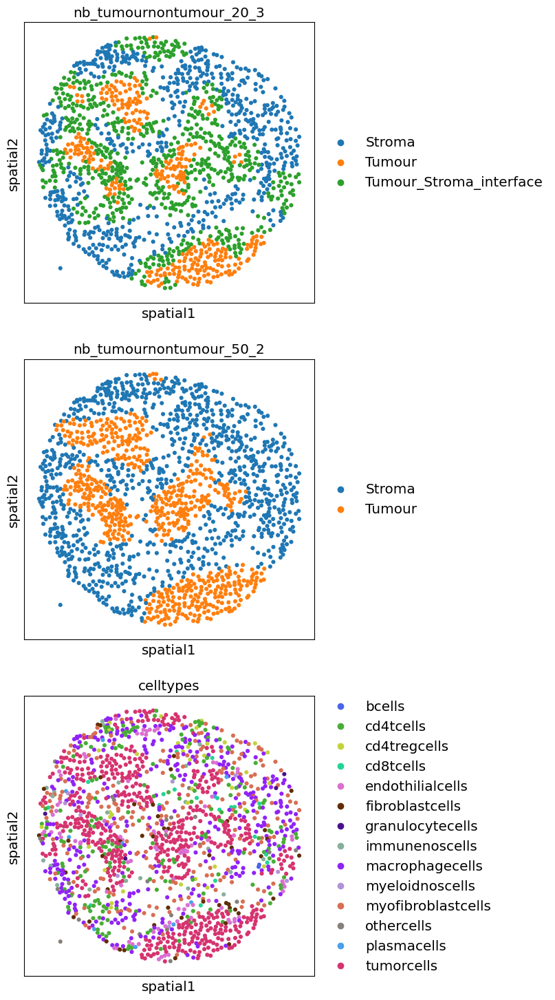

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

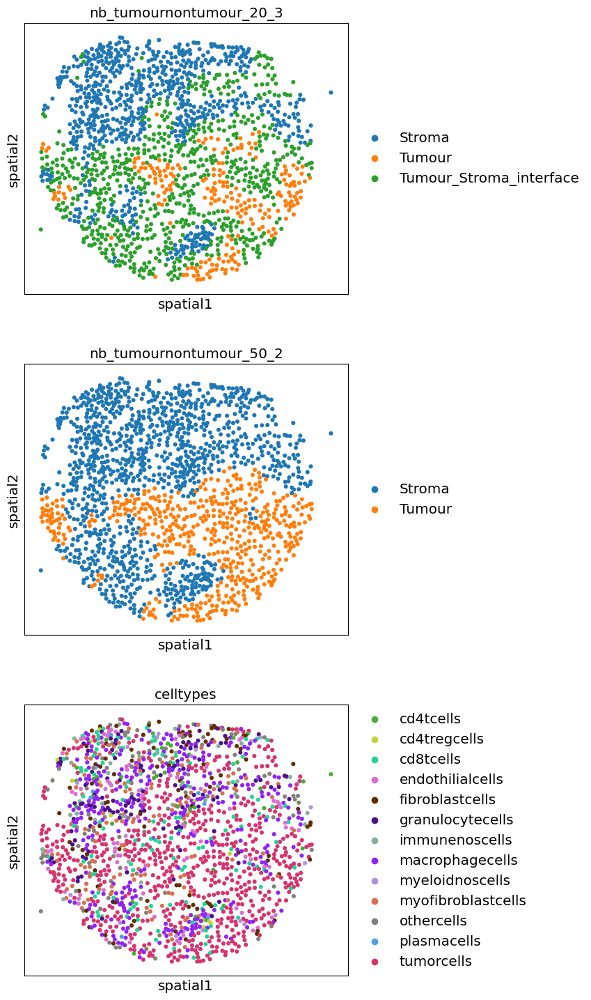

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

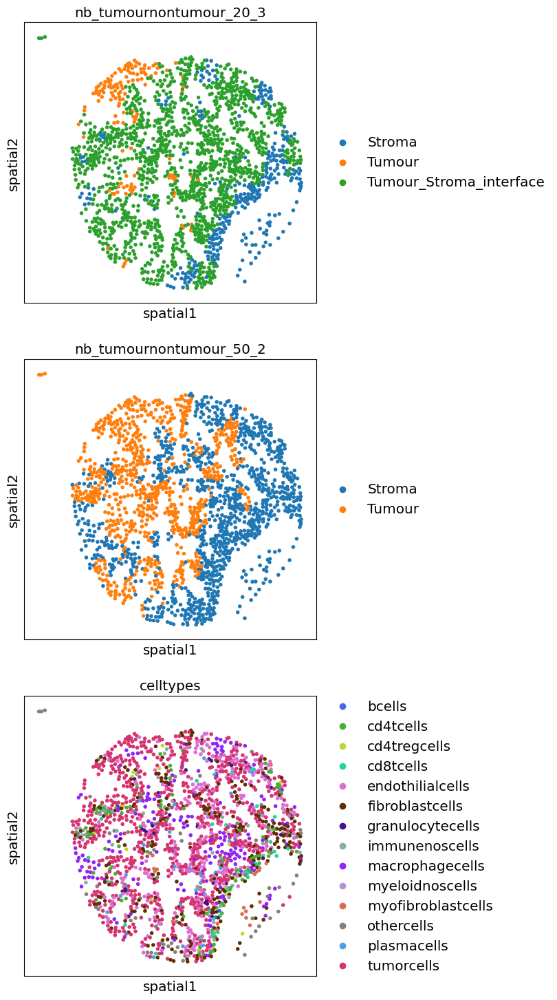

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

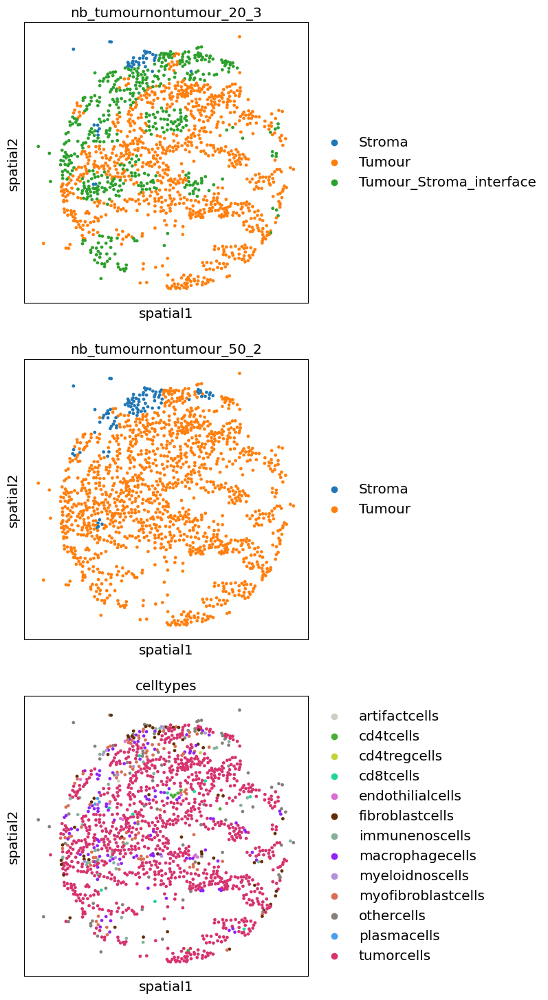

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

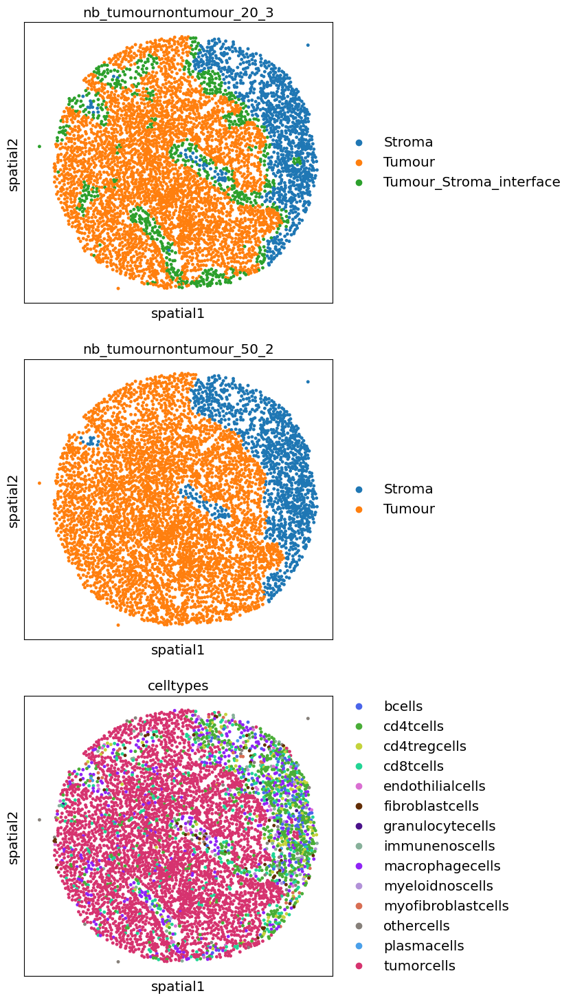

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

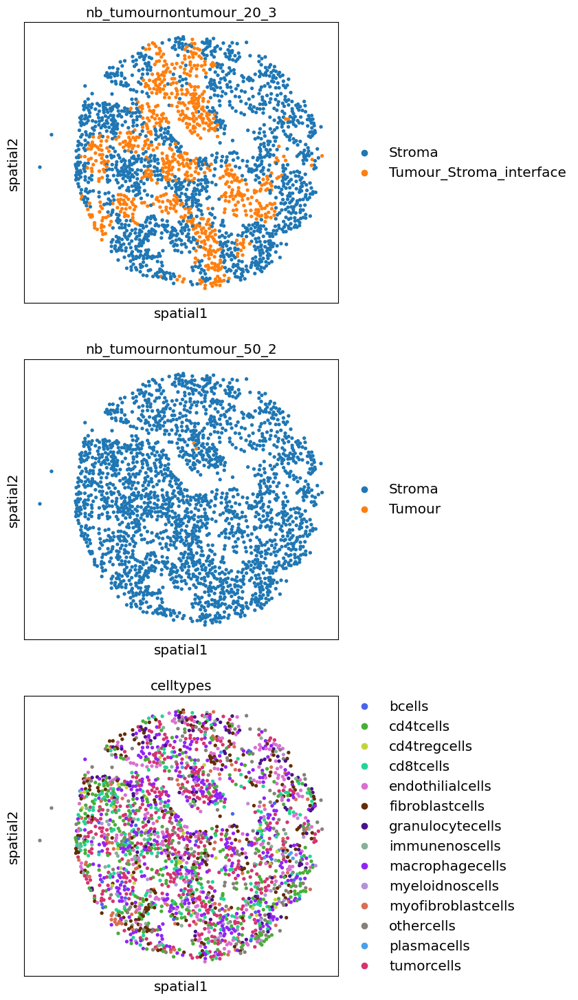

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

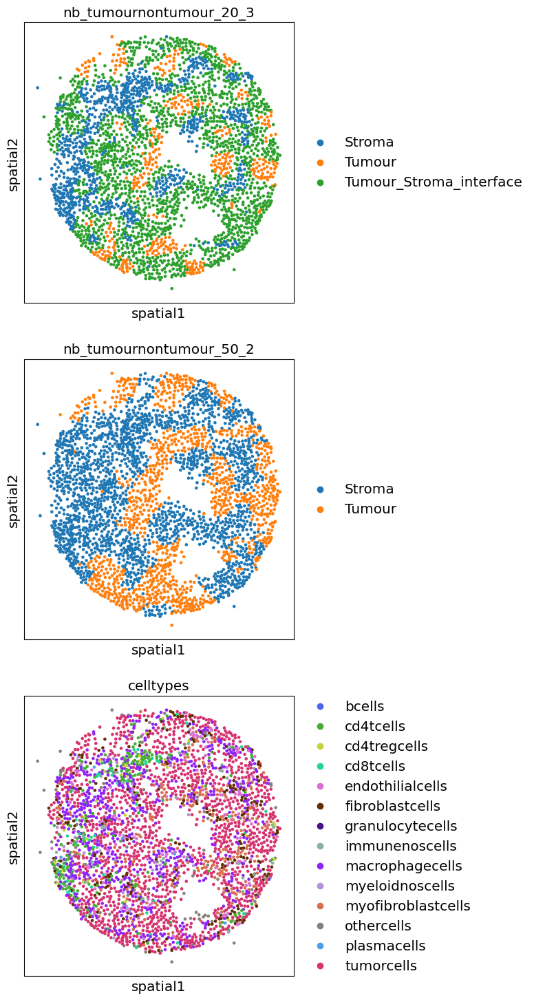

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

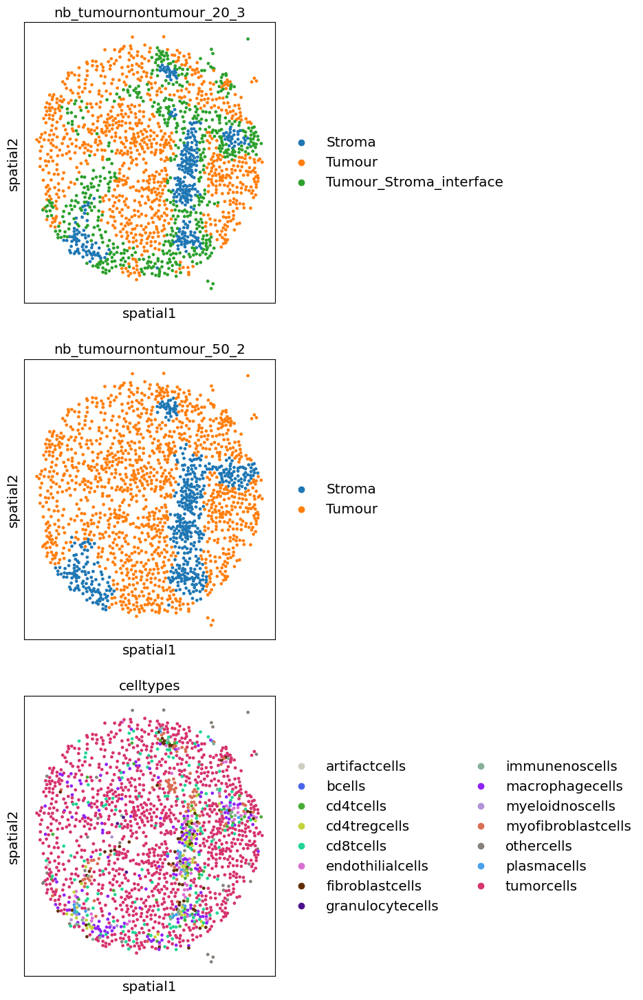

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

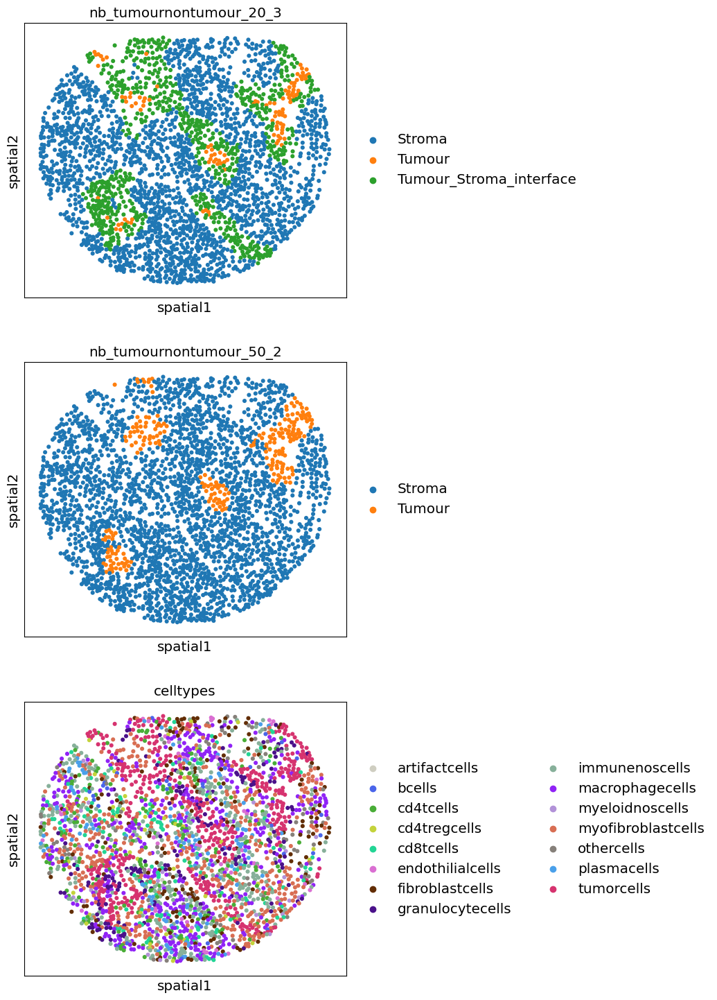

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

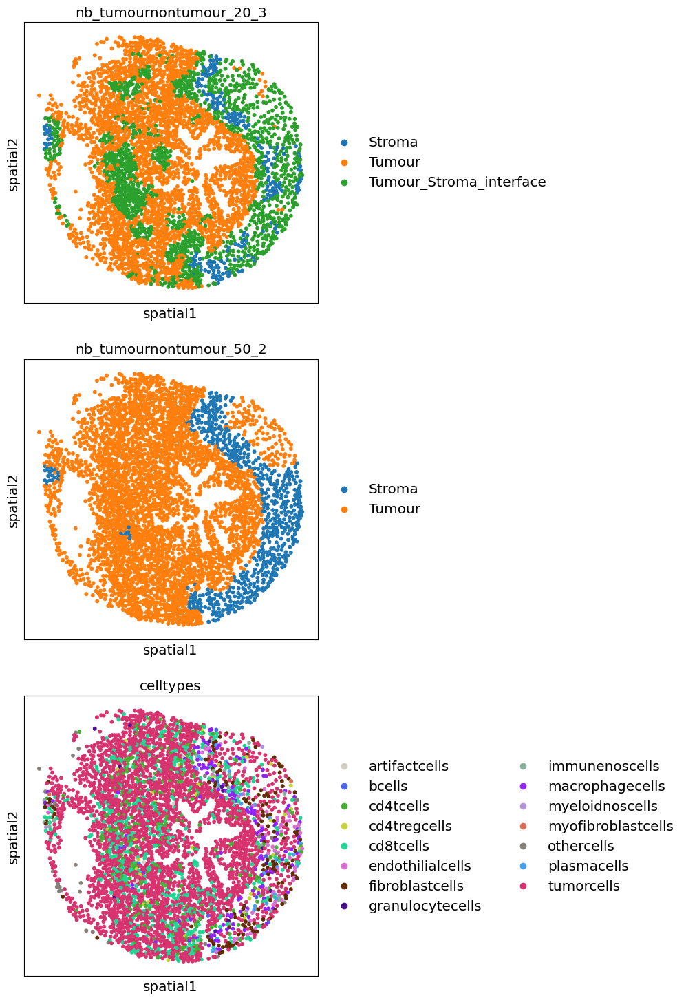

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

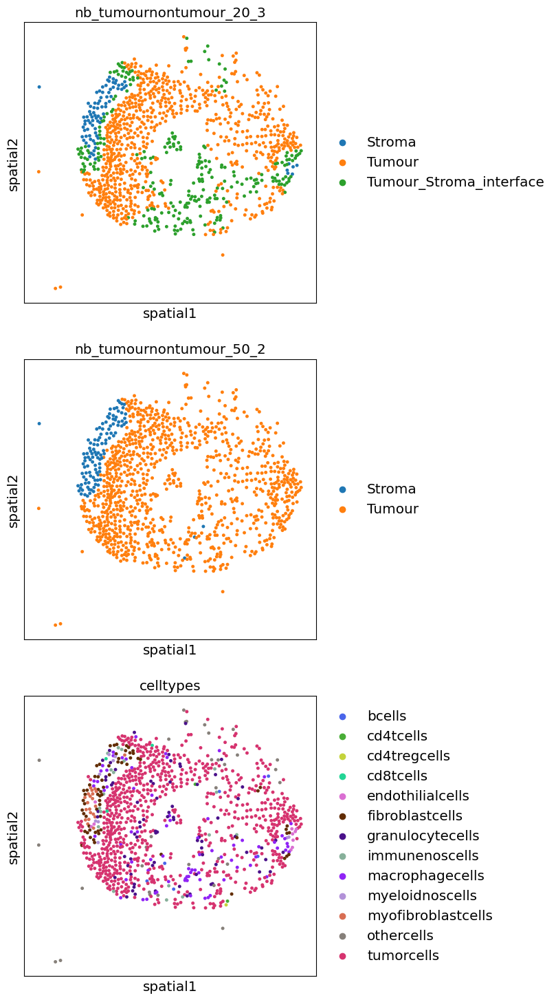

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

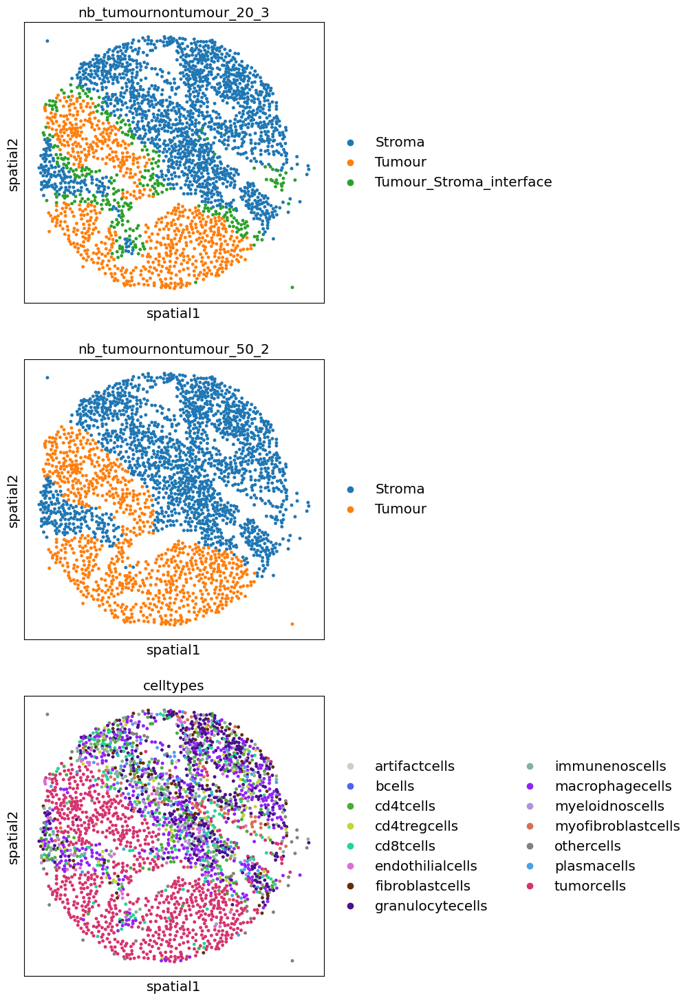

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

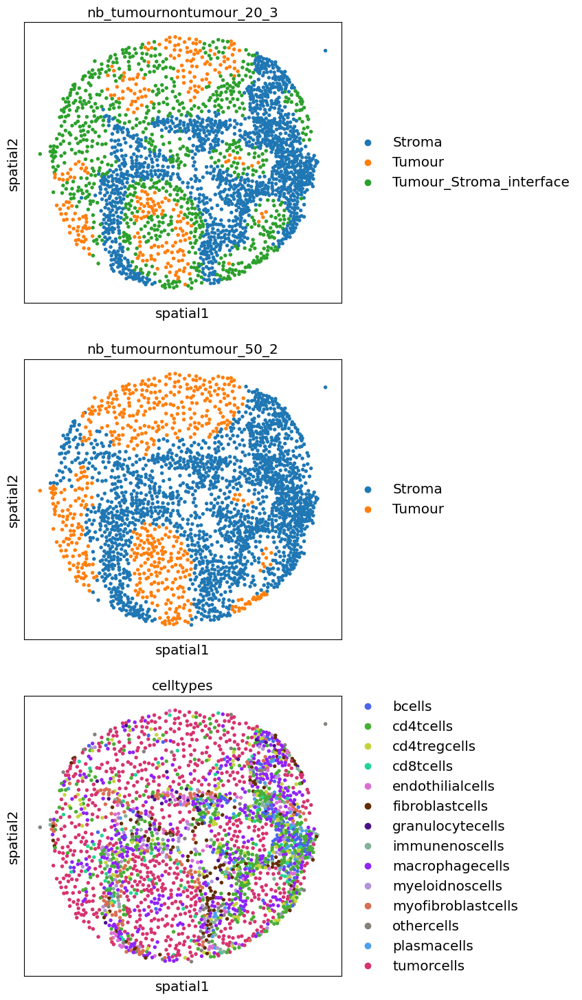

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

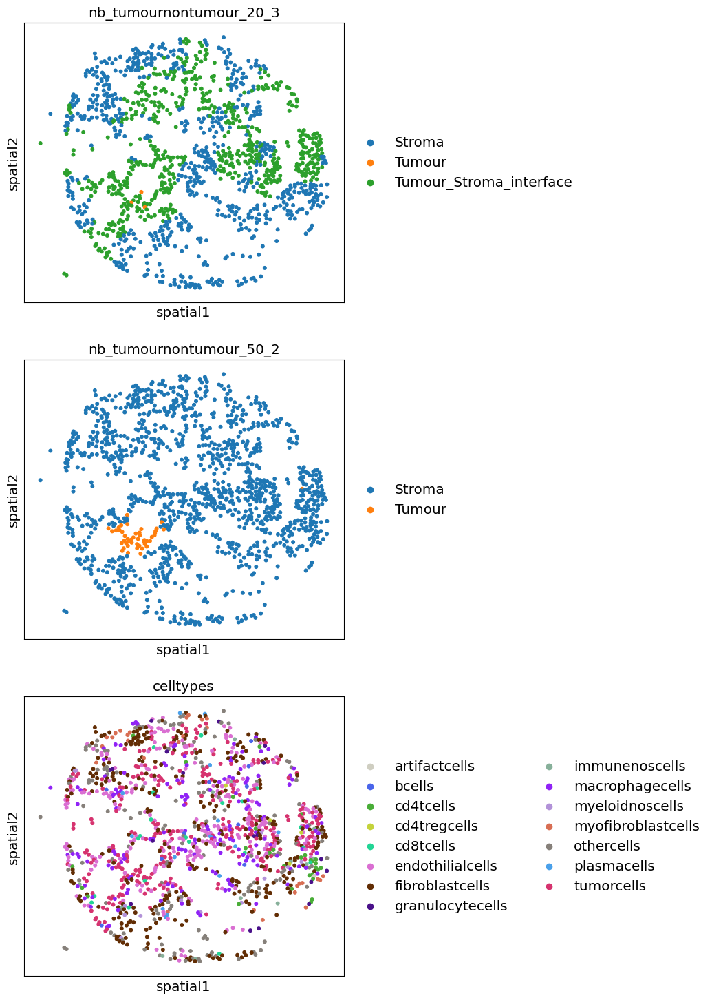

/tmp/ipykernel_404178/3636745894.py:28: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:29: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
/home/akilgall/miniconda3/envs/analysis/lib/python3.10/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/tmp/ipykernel_404178/3636745894.py:30: FutureWarn

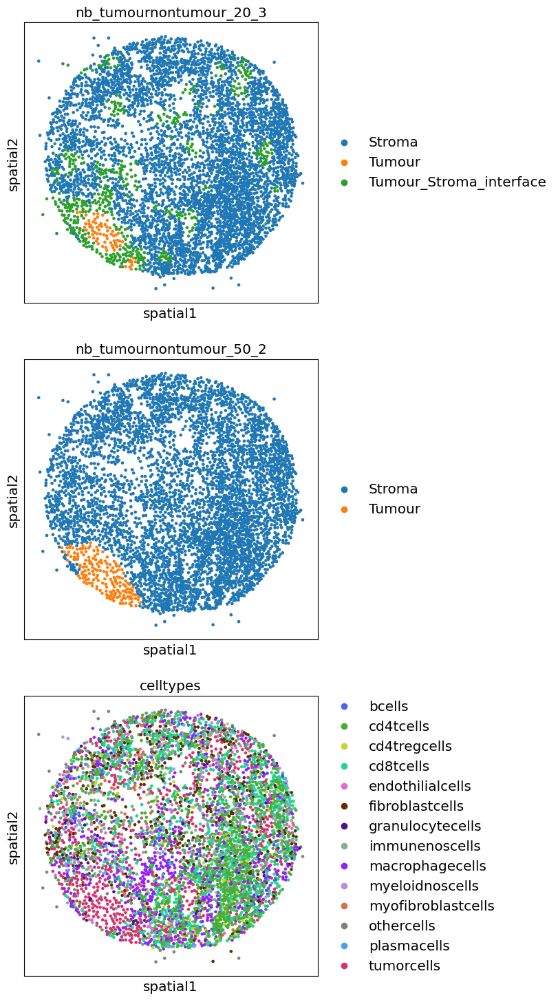

In [99]:
import matplotlib
from spatial_analysis.utils import ObsHelper
samplepropshelper = ObsHelper(adata, "patientid")
from itertools import cycle
colors = cycle(plt.cm.tab20(np.linspace(0,1,20)))
cell_types_colors = {
        "tumorcells": "#d6336f",
        "bcells": "#4a65ea", # Dark blue
        "plasmacells": "#4aa0ea", # a lighter blue; related to b cells
        "cd4tcells": "#49ad37", # base green
        "cd4tregcells": "#c4d33b", # yellowey green. Less toxic function, more 'helping', T cell logistics
        "cd8tcells": "#22d595", # a more toxic, brighter turq,green to indicate killing function
        "endothilialcells": "#da6fd2", # pink, related to blood. avoid red to not confused with 'detrimental' cells like tumor cells
        "fibroblastcells": "#622d04", # brown, reminiscent of VIM staining with HRP DAB
        "myofibroblastcells": "#d86e53", # a redder brown / orange
        "myeloidcells": "#8f56d5", # Base Purple for Myeloids
        "granulocytecells": "#4a118a", # Darker purple to represent more density and size
        "macrophagecells": "#9023f6", # Brighter purple
        # Other cell types, base
        "immunenoscells": "#87b09a", # muted green
        "myeloidnoscells": "#b292d8", # Muted version of hte myeloid_cells
        "othercells": "#86807a", # Muted version of the other cells
        "artifactcells": "#cfcec1", # Muted version of the other cells
    }

for pat in set(adata.obs['patientid']):
    fig, ax = plt.subplots(nrows=3, figsize=(6, 18))
    sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_20_3', ax=ax[0], show=False)
    sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='nb_tumournontumour_50_2', ax=ax[1], show=False)
    sc.pl.spatial(adata[adata.obs['patientid'] == pat], spot_size=20, color='celltypes', palette=cell_types_colors, ax=ax[2], show=False, sort_order=False)
    #plt.savefig(f"{pat}_CNk3.svg")
    plt.show()

In [100]:
adata.write(r'AnnDataFiles/2-output_nsclc_ytma_features_preandpost.h5ad')